# Analysis of Final Non-Adaptive Runs

In [29]:
import EnsEquil as ee 
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import rcParams, rcParamsDefault
import pickle
rcParams.update(rcParamsDefault)
plt.style.use("seaborn-colorblind")
plt.rc('text.latex', preamble=r'\usepackage{amsmath}')
from typing import List, Tuple, Dict, Callable, Union
%matplotlib inline
from scipy.stats import linregress, kruskal, t, sem

In [68]:
# Dict mapping directory names to calculation names
calc_dirs = {
    "t4l_0.2": "t4l_200ps",
    "t4l_6": "t4l_5000ps",
    "t4l_30": "t4l_30000ps",
    "mif_0.2": "mif_180_anti_200ps",
    "mif_6": "mif_180_anti_5000ps",
    "mif_30": "mif_180_anti_30000ps",
    "mdm2_nut_0.2": "mdm2_nutlin_single_pose_200ps",
    "mdm2_nut_6": "mdm2_nutlin_single_pose_5000ps",
    "mdm2_nut_30": "mdm2_nutlin_single_pose_30000ps",
    "mdm2_pip_0.2": "mdm2_pip2_short_200ps",
    "mdm2_pip_6": "mdm2_pip2_short_5000ps",
    "mdm2_pip_30": "mdm2_pip2_short_30000ps",
    "pde_0.2": "pde2a_p10_200ps",
    "pde_6": "pde2a_p10_5000ps",
    "pde_30": "pde2a_p10_30000",
}


ligs = {
    "T4L": {"0.2 ns": "t4l_0.2", "6 ns": "t4l_6", "30 ns": "t4l_30"},
    "MIF": {"0.2 ns": "mif_0.2", "6 ns": "mif_6", "30 ns": "mif_30"},
    "MDM2-Nutlin": {"0.2 ns": "mdm2_nut_0.2", "6 ns": "mdm2_nut_6", "30 ns": "mdm2_nut_30"},
    "MDM2-PIP2": {"0.2 ns": "mdm2_pip_0.2", "6 ns": "mdm2_pip_6", "30 ns": "mdm2_pip_30"},
    "PDE2A": {"0.2 ns": "pde_0.2", "6 ns": "pde_6", "30 ns": "pde_30"},
}

# List the systems in the order we want them plotted
systems = ["T4L", "MIF", "MDM2-PIP2", "PDE2A", "MDM2-Nutlin"]

## Code to Run Convergence Analysis

The following code was run in a tmux session to analyse the convergence of the non-adaptive runs. 

In [ ]:
import EnsEquil as ee 
calc_dirs = {
    "t4l_0.2": "t4l_200ps",
    "t4l_6": "t4l_5000ps",
    "t4l_30": "t4l_30000ps",
    "mif_0.2": "mif_180_anti_200ps",
    "mif_6": "mif_180_anti_5000ps",
    "mif_30": "mif_180_anti_30000ps",
    "mdm2_nut_0.2": "mdm2_nutlin_single_pose_200ps",
    "mdm2_nut_6": "mdm2_nutlin_single_pose_5000ps",
    "mdm2_nut_30": "mdm2_nutlin_single_pose_30000ps",
    "mdm2_pip_0.2": "mdm2_pip2_short_200ps",
    "mdm2_pip_6": "mdm2_pip2_short_5000ps",
    "mdm2_pip_30": "mdm2_pip2_short_30000ps",
    "pde_0.2": "pde2a_p10_200ps",
    "pde_6": "pde2a_p10_5000ps",
    "pde_30": "pde2a_p10_30000",
}

calc_paths = [val for val in calc_dirs.values()]
print(calc_paths)

calc_iterator = ee.run._utils.SimulationRunnerIterator(calc_paths, ee.Calculation)

for calc in calc_iterator:
    print(20*"=")
    print(f"Analysing {calc.base_dir}")
    calc.analyse_convergence()
    calc._dump()

## Plot Thermodynamic Length Metrics

In [ ]:
import EnsEquil as ee
import pickle

calc_dirs = {
    "t4l_0.2": "t4l_200ps",
    "t4l_6": "t4l_5000ps",
    "t4l_30": "t4l_30000ps",
    "mif_0.2": "mif_180_anti_200ps",
    "mif_6": "mif_180_anti_5000ps",
    "mif_30": "mif_180_anti_30000ps",
    "mdm2_nut_0.2": "mdm2_nutlin_single_pose_200ps",
    "mdm2_nut_6": "mdm2_nutlin_single_pose_5000ps",
    "mdm2_nut_30": "mdm2_nutlin_single_pose_30000ps",
    "mdm2_pip_0.2": "mdm2_pip2_short_200ps",
    "mdm2_pip_6": "mdm2_pip2_short_5000ps",
    "mdm2_pip_30": "mdm2_pip2_short_30000ps",
    "pde_0.2": "pde2a_p10_200ps",
    "pde_6": "pde2a_p10_5000ps",
    "pde_30": "pde2a_p10_30000",
}


ligs = {
    "T4L": {"0.2 ns": "t4l_0.2", "6 ns": "t4l_6", "30 ns": "t4l_30"},
    "MIF": {"0.2 ns": "mif_0.2", "6 ns": "mif_6", "30 ns": "mif_30"},
    "MDM2-Nutlin": {"0.2 ns": "mdm2_nut_0.2", "6 ns": "mdm2_nut_6", "30 ns": "mdm2_nut_30"},
    "MDM2-PIP2": {"0.2 ns": "mdm2_pip_0.2", "6 ns": "mdm2_pip_6", "30 ns": "mdm2_pip_30"},
    "PDE2A": {"0.2 ns": "pde_0.2", "6 ns": "pde_6", "30 ns": "pde_30"},
}
# Dict to store all the gradient data objects
grad_data = {}

for lig in ligs:
    grad_data[lig] = {}
    for time in ligs[lig]:
        grad_data[lig][time] = {}
        print(f"Loading gradient data for {lig} {time}")
        calc = ee.Calculation(base_dir = calc_dirs[ligs[lig][time]])
        calc.recursively_set_attr("relative_simulation_cost", 1, force=True)
        grad_data[lig][time]["bound"] = {}
        grad_data[lig][time]["free"] = {}
        grad_data[lig][time]["bound"]["restrain"] = ee.analyse.GradientData(calc.legs[0].stages[0].lam_windows, equilibrated=True)
        grad_data[lig][time]["bound"]["discharge"] = ee.analyse.GradientData(calc.legs[0].stages[1].lam_windows, equilibrated=True)
        grad_data[lig][time]["bound"]["vanish"] = ee.analyse.GradientData(calc.legs[0].stages[2].lam_windows, equilibrated=True)
        grad_data[lig][time]["free"]["discharge"] = ee.analyse.GradientData(calc.legs[1].stages[0].lam_windows, equilibrated=True)
        grad_data[lig][time]["free"]["vanish"] = ee.analyse.GradientData(calc.legs[1].stages[1].lam_windows, equilibrated=True)
        calc._close_logging_handlers()
        del(calc)

    # Save a pickle of the gradient data
    print(f"Saving gradient data for {lig}")
    with open("grad_data.pkl", "wb") as f:
        pickle.dump(grad_data, f)


Sanity check to ensure that all runs have the correct equilibration times

In [76]:
expected_equil_times = {"0.2 ns" : 0.0, "6 ns": 1, "30 ns": 10}
for lig in ligs:
    for time in ligs[lig]:
        print(f"Checking equilibration for {lig} {time}")
        calc = ee.Calculation(base_dir = calc_dirs[ligs[lig][time]])
        for leg in calc.legs:
            for stage in leg.stages:
                for lam_win in stage.lam_windows:
                    if not lam_win._equilibrated == True:
                        print(f"Stage {stage} in {leg} of {calc.base_dir} is not equilibrated")
                    if time == "6 ns" and stage.stage_type == ee.StageType.VANISH and leg.leg_type == ee.LegType.BOUND:
                        expected_equil_time = 3
                    else: 
                        expected_equil_time = expected_equil_times[time]
                    if not lam_win._equil_time == expected_equil_time:
                        print(f"Stage {stage} in {leg} of {calc.base_dir} has equilibration time {lam_win._equil_time} but expected equilibration time {expected_equil_time}")
        calc._close_logging_handlers()
        del(calc)

Checking equilibration for T4L 0.2 ns
Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...
Checking equilibration for T4L 6 ns
Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...
Checking equilibration for T4L 30 ns
Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...
Checking equilibration for MIF 0.2 ns
Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...
Checking equilibration for MIF 6 ns
Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...
Checking equilibration for MIF 30 ns
Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...
Checking equilibration for MDM2-Nutlin 0.2 ns
Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...
Checking equilibration for MDM2-Nutlin 6 ns
Loading previous Calculation. Any arguments will be overwritten..

In [3]:
with open("grad_data.pkl", "rb") as f:
    grad_data = pickle.load(f)

In [30]:
np.trapz(np.array(grad_data["T4L"]["0.2 ns"]["bound"]["restrain"].gradients).mean(axis=1).mean(axis=1), grad_data["T4L"]["0.2 ns"]["bound"]["restrain"].lam_vals)

2.20739329247901

In [31]:
np.sum(np.array(grad_data["T4L"]["0.2 ns"]["bound"]["restrain"].gradients).mean(axis=1).mean(axis=1)* grad_data["T4L"]["0.2 ns"]["bound"]["restrain"].lam_val_weights)

2.20739329247901

In [30]:
def get_imporovement_factor(grad_data: ee.analyse.GradientData, er_type: str) -> np.ndarray:
    """
    Get the improvement factor for a given gradient data object, error type and initial lambda values.
    """
    if er_type == "SEM":
        metric = grad_data.get_time_normalised_sems()
    elif er_type == "SD":
        metric = np.sqrt(grad_data.vars_intra)
    else:
        raise ValueError(f"Error type {er_type} not recognised.")
    opt = np.trapz(metric, grad_data.lam_vals)**2
    equal = np.trapz(metric**2, grad_data.lam_vals)
    # Get the predicted improvement factor
    pred = opt/equal
    # Return the improvement factor
    return pred

In [63]:
def plot_length_on_ax(ax: plt.Axes, grad_data: Dict[str, ee.analyse.GradientData], system: str, stage:str, len_type:str)-> None:
    """Plot either 'root-var' or 'sem'-based thermodynamic length metrics on an axis"""
    line_style = {"bound": "-", "free": "--"}
    improvement_factors = {"bound": [], "free": []}
    for time in grad_data[system]:
        color = ax._get_lines.get_next_color()
        for leg in grad_data[system][time]:
            # Ensure the data is present in the dictionary
            if stage not in grad_data[system][time][leg]:
                continue
            #if leg =="bound":
                #continue
            data = grad_data[system][time][leg][stage]
            quantity = data.get_time_normalised_sems(smoothen=False) if len_type == "SEM" else np.sqrt(data.vars_intra)
            ax.plot(data.lam_vals, quantity, color=color, linestyle=line_style[leg], label=f"{time} {leg}")
            improvement_factors[leg].append(get_imporovement_factor(data, len_type))

    legs = ["bound"] if stage == "restrain" else ["bound", "free"]
    for leg in legs:
        av_improvement_factor = np.mean(improvement_factors[leg])
        sd_improvement_factor = np.std(improvement_factors[leg])
        offset = 0.04 if leg == "bound" else -0.04
        ax.text(0.965, 0.935 + offset, f"IF {leg.capitalize()}: {av_improvement_factor:.2f} $\pm$ {sd_improvement_factor:.2f}", transform=ax.transAxes, horizontalalignment="right", verticalalignment="top")
    ax.set_title(f"{system} {stage.capitalize()}")
    ax.set_xlabel(r"$\lambda$")
    ylabel = r"$\sigma\left(\overline{\frac{\partial H}{\partial \lambda}}\right)$ / kcal mol$^{-1}$ ns$^{\frac{1}{2}}$" if len_type == "SEM" else r"$\sigma\left(\frac{\partial H}{\partial \lambda}\right)$ / kcal mol$^{-1}$"

    ax.set_ylabel(ylabel)


Plot the SDs

In [4]:
# List the systems in the order we want them plotted
systems = ["T4L", "MIF", "MDM2-PIP2", "PDE2A", "MDM2-Nutlin"]

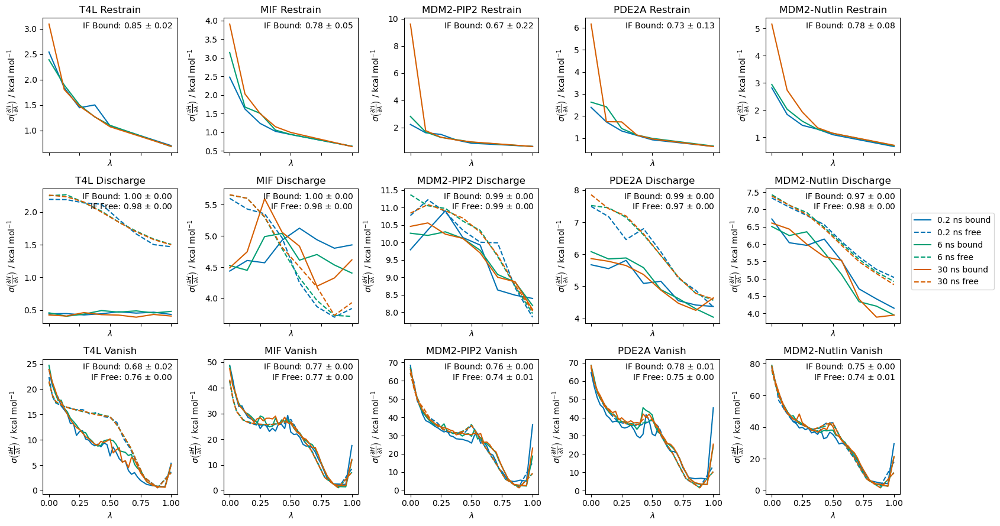

In [60]:
# Plot the SDs for all systems. Need 3 rows of 5 columns.
fig, axs = plt.subplots(3, 5, figsize=(17, 9), sharex=True)
for i, system in enumerate(systems):
    for j, stage in enumerate(grad_data[system]["0.2 ns"]["bound"]):
        plot_length_on_ax(axs[j, i], grad_data, system, stage, "SD")
# Show overall legend off to the side of all plots
axs[1, 4].legend(bbox_to_anchor=(1.05, 0.85))
plt.tight_layout()
fig.savefig("SD_non_adapt.png", bbox_inches="tight", dpi=600)

Plot the SEMs

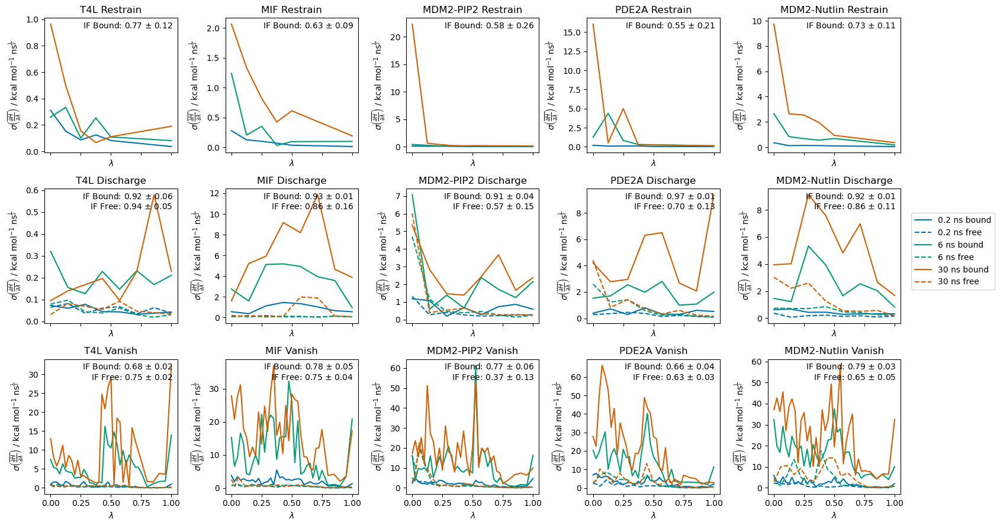

In [59]:

# Plot the SEMs for all systems. Need 3 rows of 5 columns.
fig, axs = plt.subplots(3, 5, figsize=(17, 9), sharex=True)
for i, system in enumerate(systems):
    for j, stage in enumerate(grad_data[system]["0.2 ns"]["bound"]):
        plot_length_on_ax(axs[j, i], grad_data, system, stage, "SEM")
# Show overall legend off to the side of all plots
axs[1, 4].legend(bbox_to_anchor=(1.05, 0.85))
plt.tight_layout()
fig.savefig("SEM_non_adapt.png", bbox_inches="tight", dpi=600)

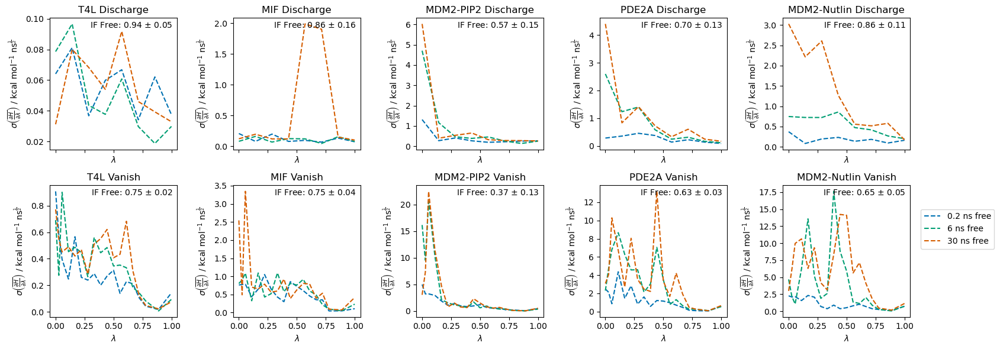

In [65]:
# Replot with just the free leg (by modifying the plot_length_on_ax function) 
fig, axs = plt.subplots(2, 5, figsize=(17, 6), sharex=True)
for i, system in enumerate(systems):
    for j, stage in enumerate(grad_data[system]["0.2 ns"]["free"]):
        plot_length_on_ax(axs[j, i], grad_data, system, stage, "SEM")
# Show overall legend off to the side of all plots
axs[1, 4].legend(bbox_to_anchor=(1.05, 0.85))
plt.tight_layout()
fig.savefig("SEM_non_adapt_free_only.png", bbox_inches="tight", dpi=600)

## Plot SD Lengths vs Number of Atoms in Ligands

In [108]:
atom_nums = {"T4L":12, "MIF":34, "MDM2-PIP2":54, "PDE2A":67, "MDM2-Nutlin":72}

In [9]:

thermo_lengths_sd ={}
for system in systems:
    thermo_lengths_sd[system] = {}
    for time in grad_data[system]:
        thermo_lengths_sd[system][time] = {}
        for leg in grad_data[system][time]:
            thermo_lengths_sd[system][time][leg] = {}
            for stage in grad_data[system][time][leg]:
                data = grad_data[system][time][leg][stage]
                thermo_lengths_sd[system][time][leg][stage] = np.trapz(np.sqrt(data.vars_intra), data.lam_vals)

thermo_lengths_sem ={}
for system in systems:
    thermo_lengths_sem[system] = {}
    for time in grad_data[system]:
        thermo_lengths_sem[system][time] = {}
        for leg in grad_data[system][time]:
            thermo_lengths_sem[system][time][leg] = {}
            for stage in grad_data[system][time][leg]:
                data = grad_data[system][time][leg][stage]
                thermo_lengths_sem[system][time][leg][stage] = np.trapz(data.get_time_normalised_sems(smoothen=False), data.lam_vals)


In [10]:
# Move the system from the first key to part of the values
thermo_lengths_sd = {time: {leg: {stage: [thermo_lengths_sd[system][time][leg][stage] for system in atom_nums] for stage in thermo_lengths_sd[system][time][leg]} for leg in thermo_lengths_sd[system][time]} for time in thermo_lengths_sd[system]}
thermo_lengths_sem = {time: {leg: {stage: [thermo_lengths_sem[system][time][leg][stage] for system in atom_nums] for stage in thermo_lengths_sem[system][time][leg]} for leg in thermo_lengths_sem[system][time]} for time in thermo_lengths_sem[system]}

In [11]:
at_no_list = [atom_nums[system] for system in atom_nums]

In [23]:
def plot_thermo_length_vs_at_no(ax: plt.axes, thermo_lengths: Dict, stage: str, len_type: str, sq:bool=False) -> None:
    """Plot the thermodynamic length vs the number of atoms in the system"""
    marker_types = {"bound": "o", "free": "s"}

    r_sq_vals = []
    for time in thermo_lengths:
        #for leg in thermo_lengths[time]:
        for leg in ["free"]:
            #if stage == "discharge": # Exclude the pip2 data as charged
                #x = [x for i, x in enumerate(at_no_list) if i != 2]
                #y = [thermo_lengths[time][leg][stage][i] for i in range(len(at_no_list)) if i != 2]
            #else:
            x = at_no_list
            y = thermo_lengths[time][leg][stage]
            if sq:
                y = np.array(y)**2
            ax.scatter(x, y, label=f"{time} {leg}", marker=marker_types[leg])
            # Fit a line to the data and print R^2 using linear regression
            slope, intercept, r_value, p_value, std_err = linregress(x, y)
            print(f"{time} {leg} {stage} R^2: {r_value**2}")
            r_sq_vals.append(r_value**2)
    print(f"Mean R^2: {np.mean(r_sq_vals)}")

    ax.set_xlabel("Number of Ligand Atoms")
    if len_type == "SEM" and not sq:
        ax.set_ylabel(r"Thermodynamic Length (SEM) / kcal mol$^{-1}$ ns$^{\frac{1}{2}}$")
    elif len_type == "SEM" and sq:
        ax.set_ylabel("Thermodynamic Length Squared (SEM)$^2$ \n / kcal$^2$ mol$^{-2}$ ns$^{-1}$")
    elif len_type == "SD" and not sq:
        ax.set_ylabel(r"Thermodynamic Length (SD) / kcal mol$^{-1}$")
    elif len_type == "SD" and sq:
        ax.set_ylabel("Thermodynamic Length Squared (SD)$^2$ \n / kcal$^2$ mol$^{-2}$")
    ax.set_title(stage.capitalize())

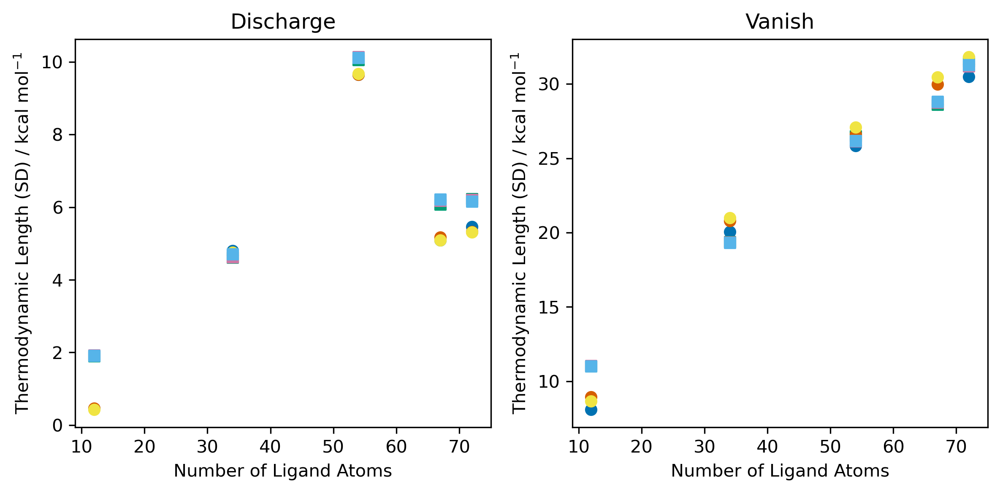

In [70]:
fig, axs = plt.subplots(1, 2, figsize=(8, 4), dpi=300)
plot_thermo_length_vs_at_no(axs[0], thermo_lengths_sd, "discharge", "SD")
plot_thermo_length_vs_at_no(axs[1], thermo_lengths_sd, "vanish", "SD")
plt.tight_layout()

0.2 ns bound discharge R^2: 0.7385896296765102
0.2 ns free discharge R^2: 0.9316807697819937
6 ns bound discharge R^2: 0.7537879947671252
6 ns free discharge R^2: 0.9309693377927835
30 ns bound discharge R^2: 0.7332445394241377
30 ns free discharge R^2: 0.9181553664578234
Mean R^2: 0.834404606316729
0.2 ns bound vanish R^2: 0.9664818935115869
0.2 ns free vanish R^2: 0.9891452063004137
6 ns bound vanish R^2: 0.9711635280164269
6 ns free vanish R^2: 0.9926242090477272
30 ns bound vanish R^2: 0.9695947665026647
30 ns free vanish R^2: 0.9929470309960828
Mean R^2: 0.9803261057291505


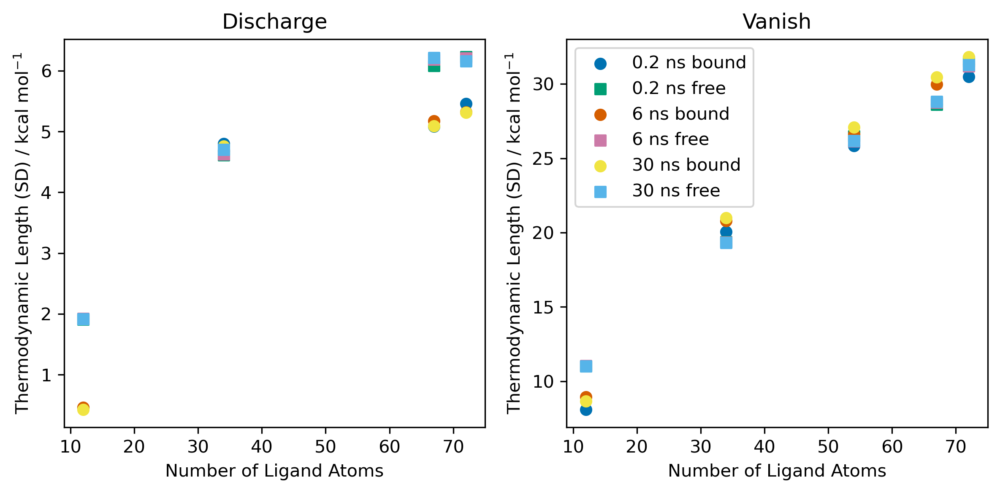

In [90]:
# Exclude PIP2 from discharge as it's charged
fig, axs = plt.subplots(1, 2, figsize=(8, 4), dpi=300)
plot_thermo_length_vs_at_no(axs[0], thermo_lengths_sd, "discharge", "SD")
plot_thermo_length_vs_at_no(axs[1], thermo_lengths_sd, "vanish", "SD")
axs[1].legend()
plt.tight_layout()
fig.savefig("thermo_length_vs_at_no_SD.png", bbox_inches="tight", dpi=600)

0.2 ns bound discharge R^2: 0.8012907469917533
0.2 ns free discharge R^2: 0.9816559400391404
6 ns bound discharge R^2: 0.8274159850071721
6 ns free discharge R^2: 0.9793163564192185
30 ns bound discharge R^2: 0.7960326792007438
30 ns free discharge R^2: 0.9692863463798846
Mean R^2: 0.8924996756729854
0.2 ns bound vanish R^2: 0.9972249286499498
0.2 ns free vanish R^2: 0.9854964426353605
6 ns bound vanish R^2: 0.9991792109913582
6 ns free vanish R^2: 0.9908622504264389
30 ns bound vanish R^2: 0.9993215696179855
30 ns free vanish R^2: 0.9903496607799163
Mean R^2: 0.9937390105168348


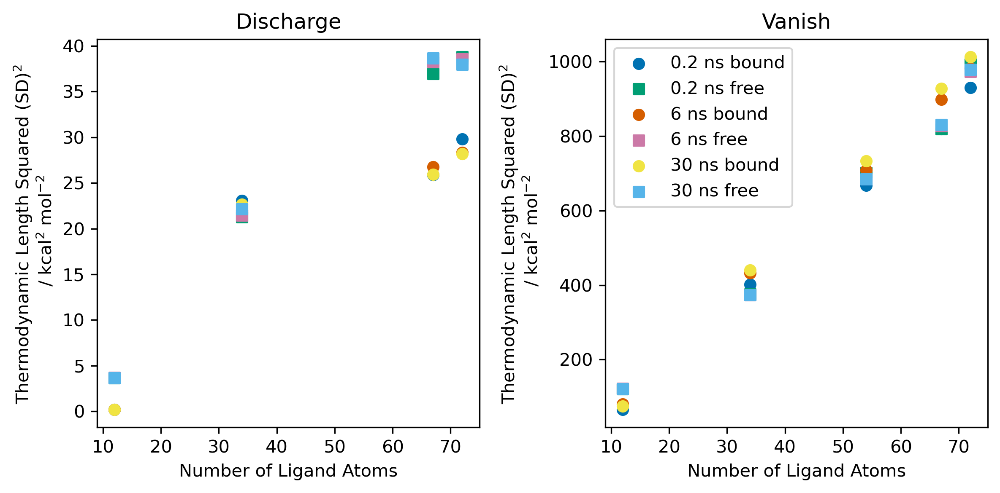

In [89]:
# Same plot as above but squared
fig, axs = plt.subplots(1, 2, figsize=(8, 4), dpi=300)
plot_thermo_length_vs_at_no(axs[0], thermo_lengths_sd, "discharge", "SD", sq=True)
plot_thermo_length_vs_at_no(axs[1], thermo_lengths_sd, "vanish", "SD", sq=True)
axs[1].legend()
plt.tight_layout()
fig.savefig("thermo_length_vs_at_no_SD_squared.png", bbox_inches="tight", dpi=600)


## Plot SEM Lengths vs number of atoms

0.2 ns bound discharge R^2: 0.08029417706539207
0.2 ns free discharge R^2: 0.44718540481343
6 ns bound discharge R^2: 0.1500067928437758
6 ns free discharge R^2: 0.7341138266596383
30 ns bound discharge R^2: 0.24611092784658795
30 ns free discharge R^2: 0.9048946786705632
Mean R^2: 0.42710096798323116
0.2 ns bound vanish R^2: 0.7328699377178752
0.2 ns free vanish R^2: 0.8144376533144804
6 ns bound vanish R^2: 0.8742700341052349
6 ns free vanish R^2: 0.9019966686141129
30 ns bound vanish R^2: 0.9258602938584705
30 ns free vanish R^2: 0.8407206546901255
Mean R^2: 0.8483592070500499


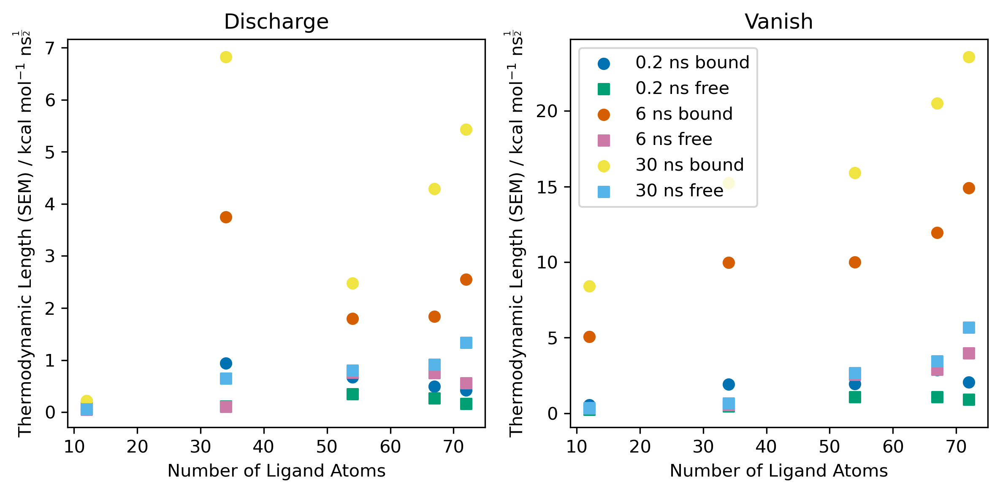

In [18]:
fig, axs = plt.subplots(1, 2, figsize=(8, 4), dpi=300)
plot_thermo_length_vs_at_no(axs[0], thermo_lengths_sem, "discharge", "SEM")
plot_thermo_length_vs_at_no(axs[1], thermo_lengths_sem, "vanish", "SEM")
axs[1].legend()
plt.tight_layout()
fig.savefig("thermo_length_vs_at_no_SEM.png", bbox_inches="tight", dpi=600)

0.2 ns bound discharge R^2: 0.08029417706539207
6 ns bound discharge R^2: 0.1500067928437758
30 ns bound discharge R^2: 0.24611092784658795
Mean R^2: 0.15880396591858528
0.2 ns bound vanish R^2: 0.7328699377178752
6 ns bound vanish R^2: 0.8742700341052349
30 ns bound vanish R^2: 0.9258602938584705
Mean R^2: 0.8443334218938602


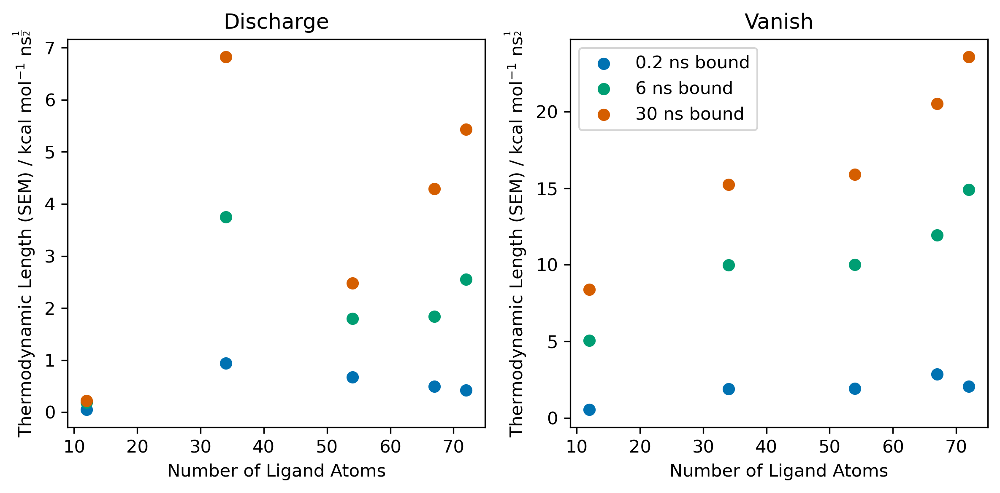

In [22]:
# Modify plotting code to only show bound
fig, axs = plt.subplots(1, 2, figsize=(8, 4), dpi=300)
plot_thermo_length_vs_at_no(axs[0], thermo_lengths_sem, "discharge", "SEM")
plot_thermo_length_vs_at_no(axs[1], thermo_lengths_sem, "vanish", "SEM")
axs[1].legend()
plt.tight_layout()
fig.savefig("thermo_length_vs_at_no_SEM_bound_only.png", bbox_inches="tight", dpi=600)

0.2 ns free discharge R^2: 0.44718540481343
6 ns free discharge R^2: 0.7341138266596383
30 ns free discharge R^2: 0.9048946786705632
Mean R^2: 0.6953979700478771
0.2 ns free vanish R^2: 0.8144376533144804
6 ns free vanish R^2: 0.9019966686141129
30 ns free vanish R^2: 0.8407206546901255
Mean R^2: 0.8523849922062395


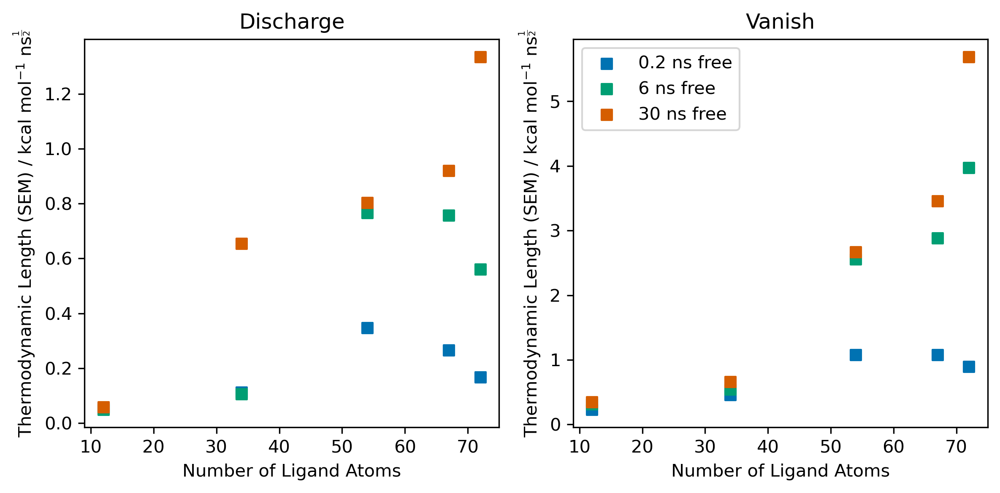

In [24]:
# Modify plotting code to only show bound
fig, axs = plt.subplots(1, 2, figsize=(8, 4), dpi=300)
plot_thermo_length_vs_at_no(axs[0], thermo_lengths_sem, "discharge", "SEM")
plot_thermo_length_vs_at_no(axs[1], thermo_lengths_sem, "vanish", "SEM")
axs[1].legend()
plt.tight_layout()
fig.savefig("thermo_length_vs_at_no_SEM_free_only.png", bbox_inches="tight", dpi=600)

## Check correlation between ligand size and free free energy change

In [106]:
def get_95_ci(data: np.ndarray) -> Tuple[float, float]:
    """Get the 95% confidence interval for a given array of data using scipy.stats.sem"""
    mean_free_energy = np.mean(data)
    conf_int = t.interval(
        0.95,
        len(data) - 1,
        mean_free_energy,
        scale=sem(data),
    )[1] - mean_free_energy # 95 % C.I.
    return conf_int

In [122]:
# Get dictionary of final free energy changes for the 30 ns runs
final_dGs = {}
for system in atom_nums:
    final_dGs[system] = {}
    calc = ee.Calculation(base_dir=calc_dirs[ligs[system]["30 ns"]])
    final_dGs[system]["dg"] = (calc._delta_g.mean(), get_95_ci(calc._delta_g))
    for leg in calc.legs:
        final_dGs[system][str(leg.leg_type)] = {}
        final_dGs[system][str(leg.leg_type)]["dg"] = (leg._delta_g.mean(), get_95_ci(leg._delta_g))
        for stage in leg.stages:
            final_dGs[system][str(leg.leg_type)][str(stage.stage_type)] = (stage._delta_g.mean(), get_95_ci(stage._delta_g))
    calc._close_logging_handlers()
    del(calc)

with open("final_dGs_30.pkl", "wb") as f:
    pickle.dump(final_dGs, f)

Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...
Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...
Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...
Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...
Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...


In [39]:
atom_nums = {"T4L":12, "MIF":34, "MDM2-PIP2":54, "PDE2A":67, "MDM2-Nutlin":72}

In [36]:
def plot_dg_vs_at_no(ax: plt.axes, n_atoms: Dict, final_dgs: Dict, leg: str, stage: str):
    """Plot the correlation between the final free energy change and the number of atoms in the system"""
    x = [n_atoms[system] for system in n_atoms]
    y = [final_dgs[system][str(leg)][str(stage)][0] for system in n_atoms]
    ax.scatter(x, y)
    slope, intercept, r_value, p_value, std_err = linregress(x, y)
    ax.plot(x, slope*np.array(x) + intercept, color="black", linestyle="--")
    # Label plot with R^2 value
    ax.text(0.05, 0.95, f"R$^2$ = {r_value**2:.2f}", transform=ax.transAxes)
    ax.set_xlabel("Number of Ligand Atoms")
    ax.set_ylabel(r"$\Delta G$ / kcal mol$^{-1}$")
    stage_name = stage.split(".")[1].capitalize()
    leg_name = leg.split(".")[1].capitalize()
    ax.set_title(f"{leg_name} {stage_name}")
    plt.tight_layout()
    

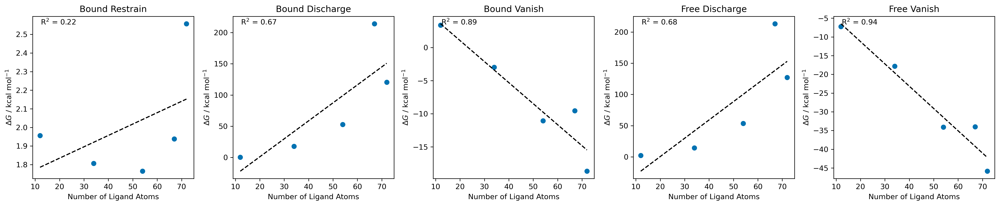

In [38]:
# Need 5 axes for the 5 stages
fig, axs = plt.subplots(1, 5, figsize=(19, 4), dpi=300)
for i, leg in enumerate(final_dGs["T4L"]):
    for j, stage in enumerate(final_dGs["T4L"][leg]):
        #if stage == "StageType.DISCHARGE":
            ## Exclude PIP2 from discharge as it's charged
            #atom_nums_ex = {system: atom_nums[system] for system in atom_nums if system != "MDM2-PIP2"}
            #final_dGs_ex = {system: final_dGs[system] for system in final_dGs if system != "MDM2-PIP2"}
            #plot_dg_vs_at_no(axs[i*3+j], atom_nums_ex, final_dGs_ex, leg, stage)
        #else:
        plot_dg_vs_at_no(axs[i*3+j], atom_nums, final_dGs, leg, stage)
fig.savefig("final_dG_vs_at_no.png", bbox_inches="tight", dpi=600)

In [43]:
# Plot the delta delta Gs for the 30 ns runs for the discharge and vanish stages
ddGs = {}
for system in atom_nums:
    ddGs[system] = {}
    for stage in "StageType.DISCHARGE", "StageType.VANISH":
        ddGs[system][stage] = {}
        dg_bound = final_dGs[system]["LegType.BOUND"][stage][0]
        dg_free = final_dGs[system]["LegType.FREE"][stage][0]
        ddGs[system][stage] = dg_free - dg_bound

In [46]:
def plot_gdg_vs_at_no(ax: plt.axes, n_atoms: Dict, ddGs: Dict, stage: str):
    """Plot the correlation between the delta delta G and the number of atoms in the system"""
    x = [n_atoms[system] for system in n_atoms]
    y = [ddGs[system][stage] for system in n_atoms]
    ax.scatter(x, y)
    slope, intercept, r_value, p_value, std_err = linregress(x, y)
    ax.plot(x, slope*np.array(x) + intercept, color="black", linestyle="--")
    # Label plot with R^2 value
    ax.text(0.05, 0.95, f"R$^2$ = {r_value**2:.2f}", transform=ax.transAxes)
    ax.set_xlabel("Number of Ligand Atoms")
    ax.set_ylabel(r"$\Delta \Delta G_{\mathrm{Bind}}$ / kcal mol$^{-1}$")
    stage_name = stage.split(".")[1].capitalize()
    ax.set_title(stage_name)
    plt.tight_layout()

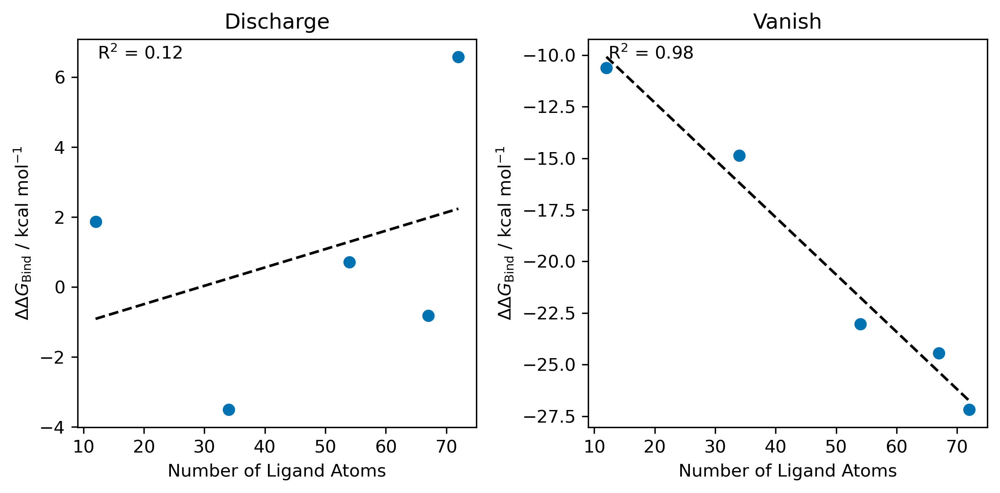

In [48]:
# Need 2 axes for the 2 stages
fig, axs = plt.subplots(1, 2, figsize=(8, 4), dpi=300)
for i, stage in enumerate(ddGs["T4L"]):
    plot_gdg_vs_at_no(axs[i], atom_nums, ddGs, stage)
    
fig.savefig("ddG_vs_at_no.png", bbox_inches="tight", dpi=600)

## Check for Significant Inter-Run Differences Between Gradient Distributions

In [ ]:
from scipy.stats import kruskal

In [81]:
data = grad_data["MDM2-PIP2"]["0.2 ns"]["bound"]["restrain"]

In [100]:
def get_sig_diff_grads(data: ee.analyse.GradientData) -> Tuple[float, float]:
    """
    Calculate the percentage of lambda windows where the gradient distributions
    are significantly different, using the Kruskal-Wallis test
    """
    n_lam = len(data.lam_vals)
    n_sig_diff = 0
    for i in range(n_lam):
        stat, p = kruskal(*data.subsampled_gradients[i])
        if p < 0.05:
            n_sig_diff += 1
    return n_lam, n_sig_diff

In [104]:
# Get a dict with the percentage of lambda windows where the gradients are significantly different
sig_diff = {}
for system in systems:
    sig_diff[system] = {}
    for time in grad_data[system]:
        sig_diff[system][time] = {}
        for leg in grad_data[system][time]:
            sig_diff[system][time][leg] = {}
            for stage in grad_data[system][time][leg]:
                n_lam, n_diff = get_sig_diff_grads(grad_data[system][time][leg][stage])
                sig_diff[system][time][leg][stage] = (n_diff / n_lam) * 100

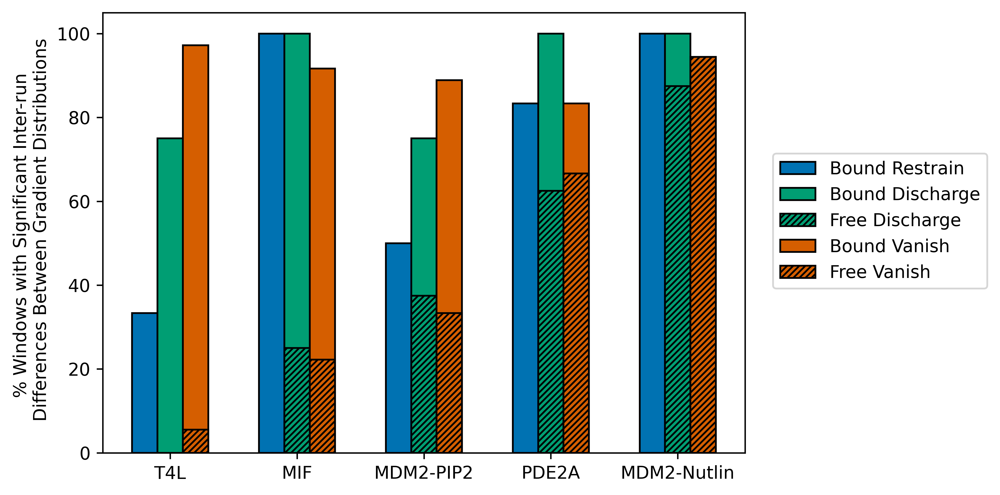

In [147]:
# Plot the percentage of lambda windows where the gradients are significantly different all on one plot as a bar plot]
fig, ax = plt.subplots(figsize=(8, 4), dpi=600)
x = np.arange(len(systems))
width = 0.2
# Plot bound and free next to each other
for i, stage in enumerate(grad_data[system]["30 ns"]["bound"]):
    # Get single colour
    color = ax._get_lines.get_next_color()
    ax.bar(x + (i * width), [sig_diff[system]["30 ns"]["bound"][stage] for system in systems], width, label=f"Bound {stage.capitalize()}", edgecolor="k", alpha=1, color=color)
    if stage != "restrain":
        ax.bar(x + (i * width), [sig_diff[system]["30 ns"]["free"][stage] for system in systems], width, label=f"Free {stage.capitalize()}", edgecolor="k", alpha=1, color=color, hatch="///////")

ax.set_xticks(x + width)
ax.set_xticklabels(systems)
ax.set_ylabel("% Windows with Significant Inter-run \n Differences Between Gradient Distributions")
# Put label off to right of plot
ax.legend(bbox_to_anchor=(1.03, 0.7))
plt.tight_layout()
fig.savefig("sig_diff_grads.png", bbox_inches="tight", dpi=600)


## Plot the convergence of the free energies

 - Do any of our protocols show clear lack of convergence for the "equilibrated" region? Plot cumulative averages of the free energies for the production regions for all legs.
 - How do the errors change? Plot cumulative last 10 ns of 30 ns runs. Multiply by 1/sqrt(time) and check for straight line.
 - Plot the overall weighted convergence/ error for the entire dataset.
 - How does convergence vary between systems? Block average of 30 ns runs without equilibration.

In [3]:
costs = {'T4L': {'bound': 0.8970899470899469,
  'free': 0.09157509157509156},
 'MIF': {'bound': 0.9984126984126981,
  'free': 0.18416768416768411},
 'MDM2-Nutlin': {'bound': 0.506564765824025,
  'free': 0.17450142450142442},
 'MDM2-PIP2': {'bound': 0.548148148148148,
   'free': 0.13838013838013835},
 'PDE2A': {'bound': 2.486772486772486,
  'free': 0.17348392348392347}}

### Cumulative averages of the free energies for the production regions for all legs

In [ ]:
import EnsEquil as ee
import pickle
import logging

# Dict mapping directory names to calculation names
calc_dirs = {
    "t4l_0.2": "t4l_200ps",
    "t4l_6": "t4l_5000ps",
    "t4l_30": "t4l_30000ps",
    "mif_0.2": "mif_180_anti_200ps",
    "mif_6": "mif_180_anti_5000ps",
    "mif_30": "mif_180_anti_30000ps",
    "mdm2_nut_0.2": "mdm2_nutlin_single_pose_200ps",
    "mdm2_nut_6": "mdm2_nutlin_single_pose_5000ps",
    "mdm2_nut_30": "mdm2_nutlin_single_pose_30000ps",
    "mdm2_pip_0.2": "mdm2_pip2_short_200ps",
    "mdm2_pip_6": "mdm2_pip2_short_5000ps",
    "mdm2_pip_30": "mdm2_pip2_short_30000ps",
    "pde_0.2": "pde2a_p10_200ps",
    "pde_6": "pde2a_p10_5000ps",
    "pde_30": "pde2a_p10_30000",
}


ligs = {
    "T4L": {"0.2 ns": "t4l_0.2", "6 ns": "t4l_6", "30 ns": "t4l_30"},
    "MIF": {"0.2 ns": "mif_0.2", "6 ns": "mif_6", "30 ns": "mif_30"},
    "MDM2-Nutlin": {"0.2 ns": "mdm2_nut_0.2", "6 ns": "mdm2_nut_6", "30 ns": "mdm2_nut_30"},
    "MDM2-PIP2": {"0.2 ns": "mdm2_pip_0.2", "6 ns": "mdm2_pip_6", "30 ns": "mdm2_pip_30"},
    "PDE2A": {"0.2 ns": "pde_0.2", "6 ns": "pde_6", "30 ns": "pde_30"},
}

# Code to generate dictionary of 100 blocks of free energy changes for each stage for each leg for each time for each system
dgs_conv_nonequil = {}
for lig in ligs:
    dgs_conv_nonequil[lig] = {}
    for time in ligs[lig]:
        dgs_conv_nonequil[lig][time] = {}
        print(f"Analysing {lig} {time}")
        calc = ee.Calculation(base_dir = calc_dirs[ligs[lig][time]], stream_log_level=logging.CRITICAL)
        for leg in calc.legs:
            dgs_conv_nonequil[lig][time][str(leg.leg_type)] = {}
            for stage in leg.stages:
                dgs_conv_nonequil[lig][time][str(leg.leg_type)][str(stage.stage_type)] = {}
                fracts, dgs = stage.analyse_convergence(mode="block", equilibrated=False)
                dgs_conv_nonequil[lig][time][str(leg.leg_type)][str(stage.stage_type)]["fracts"] = fracts
                dgs_conv_nonequil[lig][time][str(leg.leg_type)][str(stage.stage_type)]["dgs"] = dgs
        calc._close_logging_handlers()
        del(calc)

        # Write most recent version of the dictionary to a pickle
        with open("dgs_conv_nonequil.pkl", "wb") as f:
            pickle.dump(dgs_conv_nonequil, f)


Also repeated the above but for only the equilibrated regions.

In [6]:
# Convert fractions to GPU hours. For the unequilibrated leg, do this by multiplying
# by first converting the fracts to simulation times, then multipling these by the 
# relative simulation cost * the simulation cost reference of 0.21 hr / ns
REF_COST = 0.21 # GPU hours per ns

dg_dicts = {"equil": dgs_conv_equil, "nonequil": dgs_conv_nonequil}
for dg_type, dg_dict in dg_dicts.items():
    for lig in dg_dict:
        print(f"Converting {lig} {dg_type}")
        for time in dg_dict[lig]:
            calc = ee.Calculation(base_dir = calc_dirs[ligs[lig][time]])
            for leg in calc.legs:
                for stage in leg.stages:
                    cost = REF_COST * costs[lig][str(leg.leg_type).split(".")[1].lower()]
                    start_time = 0 if dg_type == "nonequil" else stage.equil_time * stage.ensemble_size
                    end_time = stage.tot_simtime
                    fracts = np.array(dg_dict[lig][time][str(leg.leg_type)][str(stage.stage_type)]["fracts"])
                    times = ((end_time - start_time) * fracts ) + start_time
                    gpu_times = times * cost
                    dg_dict[lig][time][str(leg.leg_type)][str(stage.stage_type)]["sim_times"] = times
                    dg_dict[lig][time][str(leg.leg_type)][str(stage.stage_type)]["gpu_times"] = gpu_times

            calc._close_logging_handlers()
            del(calc)

Converting T4L equil
Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...
Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...
Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...
Converting MIF equil
Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...
Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...
Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...
Converting MDM2-Nutlin equil
Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...
Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...
Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...
Converting MDM2-PIP2 equil
Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...
Loading prev

In [7]:
for dg_type, dg_dict in dg_dicts.items():
    with open(f"dgs_conv_{dg_type}_times.pkl", "wb") as f:
        pickle.dump(dg_dict, f)

In [68]:
with open("dgs_conv_equil_times.pkl", "rb") as f:
    dgs_conv_equil = pickle.load(f)

with open("dgs_conv_nonequil_times.pkl", "rb") as f:
    dgs_conv_nonequil = pickle.load(f)

In [69]:
with open("final_dGs_30.pkl", "rb") as f:
    final_dGs = pickle.load(f)

In [166]:
test_data = dgs_conv_equil["MDM2-PIP2"]["30 ns"]["LegType.BOUND"]["StageType.RESTRAIN"]

In [167]:
test_data["sim_times"]

array([330., 360., 390., 420., 450., 480., 510., 540., 570., 600., 630.,
       660., 690., 720., 750., 780., 810., 840., 870., 900.])

In [168]:
# List the systems in the order we want them plotted
systems = ["T4L", "MIF", "MDM2-PIP2", "PDE2A", "MDM2-Nutlin"]

# Plot the convergence of the free energy changes for each stage for each leg for each time for each system
def plot_dgs_conv(ax: plt.axes, dg_dict: Dict, leg: str, stage: str, time: str, system: str, equil: bool, show_final_dg: bool = True) -> None:
    """Plot the convergence of the free energy changes for a given leg, stage, time and system"""
    # Get the data for the given leg, stage, time and system
    data = dg_dict[system][time][leg][stage]
    # Get the simulation times
    n_runs = len(data["dgs"])
    times = np.array(data["gpu_times"])
    # Get the free energy changes
    dgs = np.array(data["dgs"])
    # Calculate the 95 % CI with scipy
    mean_free_energy = np.mean(dgs, axis=0)
    conf_int = (
    t.interval(
        0.95,
        len(dgs) - 1,
        mean_free_energy,
        scale=sem(dgs),
    )[1]
    - mean_free_energy
    )  # 95 % C.I.
    # Add a horizontal line at the final free energy change and dotted lines at the 95 % CI
    if show_final_dg:
        final_dg, final_dg_err = final_dGs[system][leg][stage]
        # Make the lines lighter
        ax.axhline(final_dg, color="black", linestyle="--", alpha=0.5)
        ax.axhline(final_dg + final_dg_err, color="black", linestyle=":", alpha=0.5)
        ax.axhline(final_dg - final_dg_err, color="black", linestyle=":", alpha=0.5)
    # Plot the free energy changes against the simulation times
    ax.plot(times, mean_free_energy, label=f"{time}")
    # Fill between to show the 95 % CI
    ax.fill_between(times, mean_free_energy - conf_int, mean_free_energy + conf_int, alpha=0.5)
    # Label the plot
    ax.set_xlabel("GPU Hours")
    ax.set_ylabel(r"$\Delta G$ / kcal mol$^{-1}$")
    stage_str = stage.split(".")[1].capitalize()
    leg_str = leg.split(".")[1].capitalize()
    ax.set_title(f"{system} {leg_str} {stage_str}")
    ax.legend()
    plt.tight_layout()

    
def plot_dgs_conv_all(dg_dict: Dict, times = ["0.2 ns", "6 ns", "30 ns"], scale=False, show_final_dg=True) -> Tuple[plt.Figure, plt.Axes]:
    """Plot the convergence of the free energy changes for each stage for each leg for each time for each system"""
    # Need 5 axes for the for each system
    n_systems = len(dg_dict)
    # Share y-axis scales along rows
    fig, axs = plt.subplots(5, n_systems, figsize=(4*5, 4*n_systems), dpi=300)
    for i, system in enumerate(systems):
        for time in times:
            ax_ind = 0
            for j, leg in enumerate(dg_dict[system][time]):
                for k, stage in enumerate(dg_dict[system][time][leg]):
                    plot_dgs_conv(axs[ax_ind, i], dg_dict, leg, stage, time, system, equil=True, show_final_dg=show_final_dg)
                    ax_ind += 1

    if scale:
        # Set the y-axis scales to be the same within rows (same stages, different systems)
        for i in range(5):
            # Get the largest difference between the upper and lower bounds of the y-axis
            y_diff = max([ax.get_ylim()[1] - ax.get_ylim()[0] for ax in axs[i, :]])
            y_diff /=2
            for j in range(n_systems):
                # Set the y-axis limits to be the mean +/- half the difference
                ax_mean = np.mean(axs[i, j].get_ylim())
                axs[i, j].set_ylim(ax_mean - y_diff, ax_mean + y_diff)
        
    return fig, axs

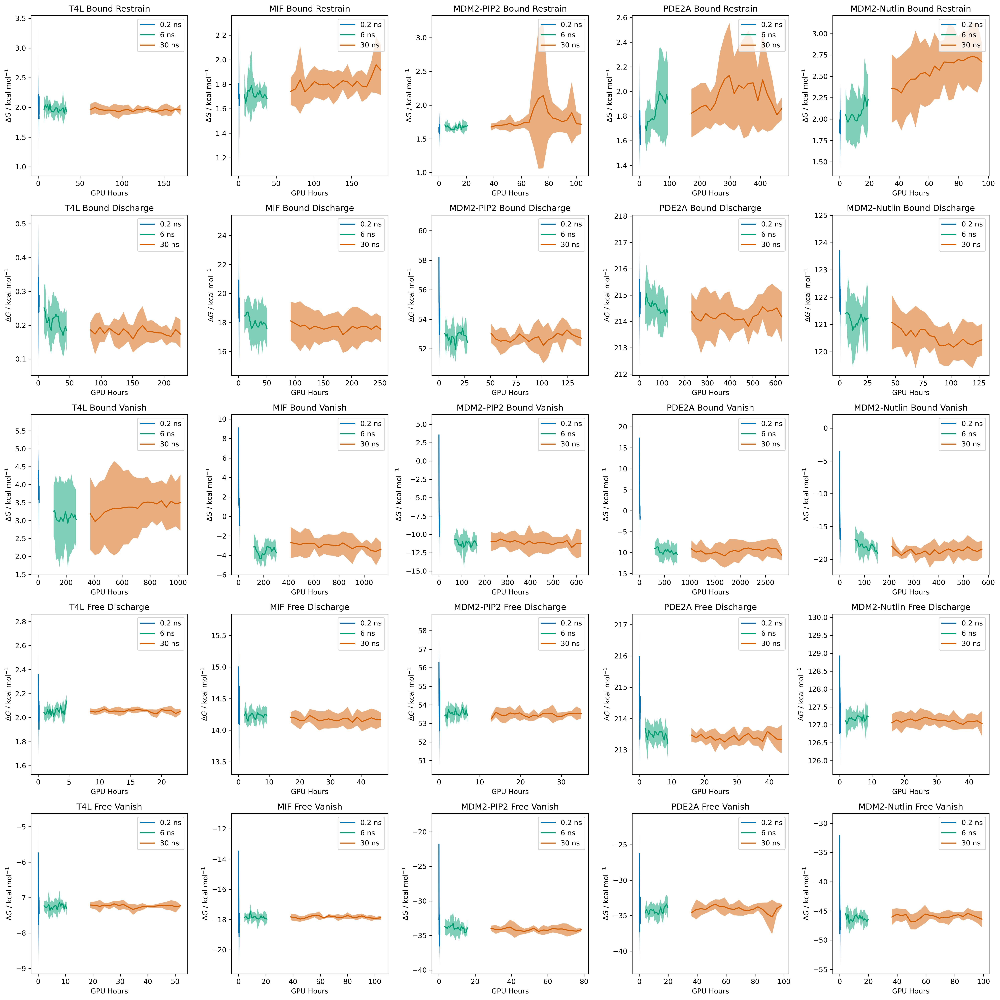

In [169]:
fig, ax = plot_dgs_conv_all(dgs_conv_equil, show_final_dg = False)
fig.savefig("dgs_conv_equil.png", bbox_inches="tight", dpi=600)

30 ns runs with 10 ns discarded generally seem steady - only exception is MDM2 nutlin - drifts might be due to binding pose instablility issues?

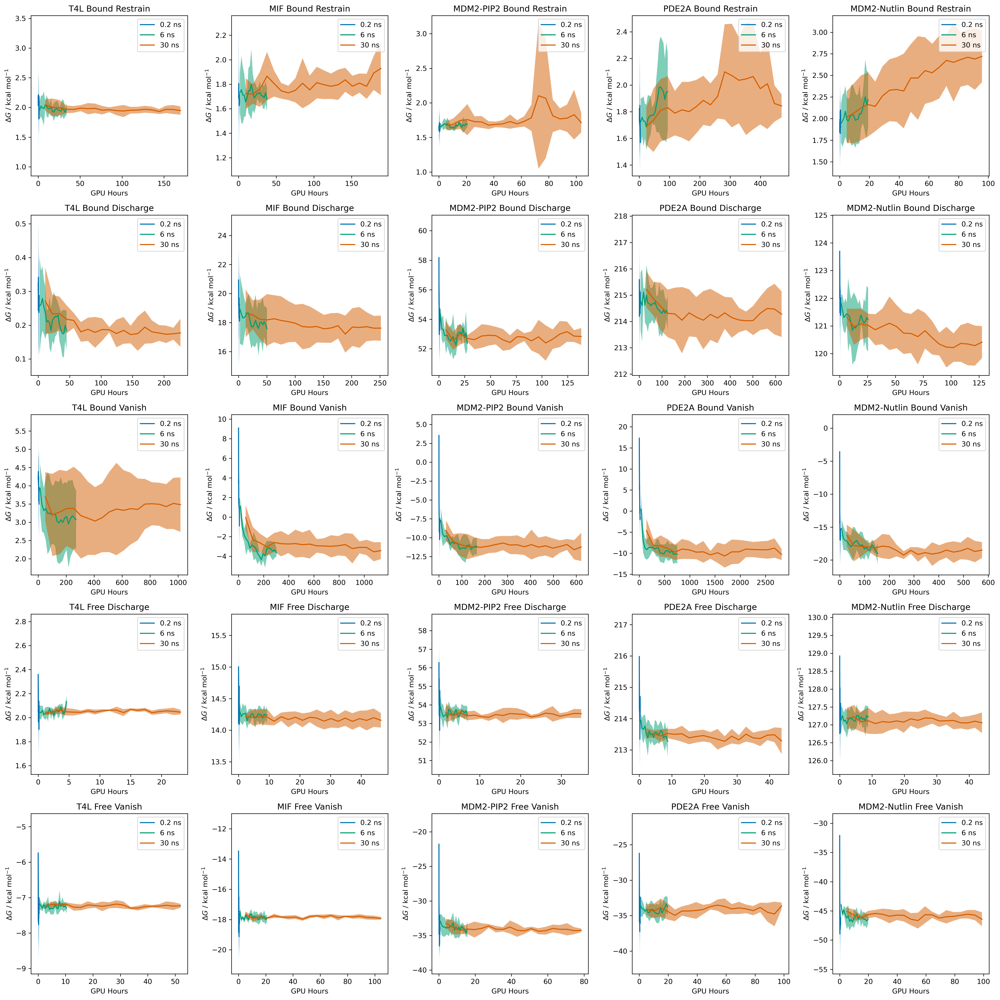

In [171]:
fig, axs = plot_dgs_conv_all(dgs_conv_nonequil, show_final_dg = False)
fig.savefig("dgs_conv_nonequil.png", bbox_inches="tight", dpi=600)

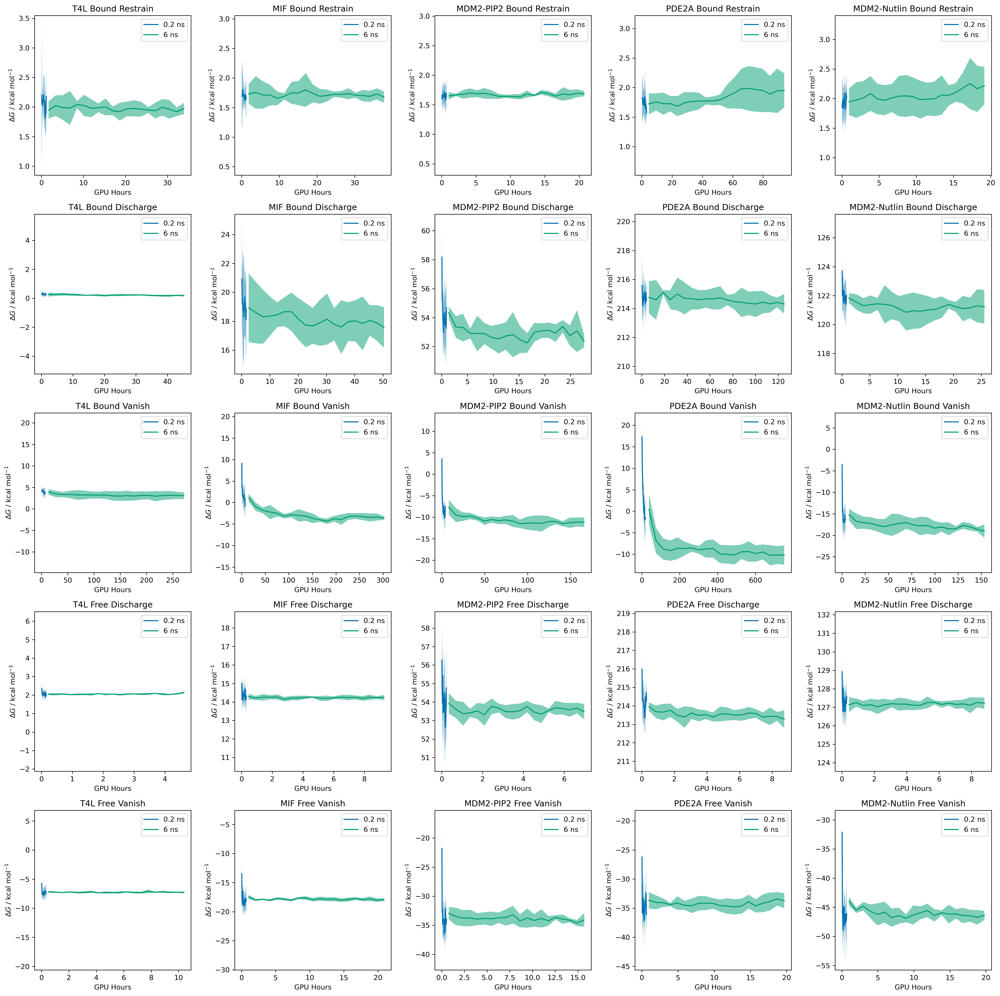

In [172]:
fig, ax = plot_dgs_conv_all(dgs_conv_nonequil, times = ["0.2 ns", "6 ns"], scale=True, show_final_dg = False)
fig.savefig("dgs_conv_nonequil_02_6_scaled.png", bbox_inches="tight", dpi=600)

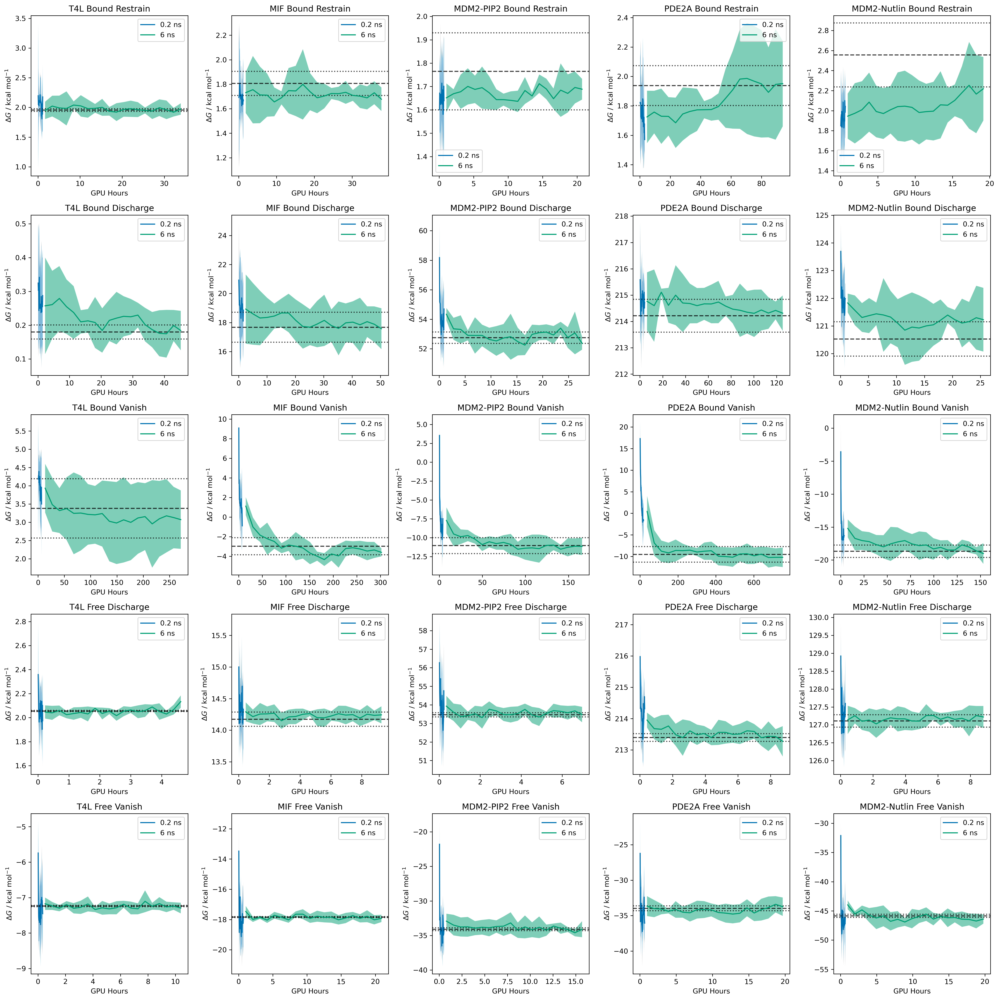

In [173]:
fig, ax = plot_dgs_conv_all(dgs_conv_nonequil, times = ["0.2 ns", "6 ns"], scale=False)
fig.savefig("dgs_conv_nonequil_02_6.png", bbox_inches="tight", dpi=600)

Clearly, bound vanish is the greatest contributer to drift, and the biggest problem is for PDE2A.

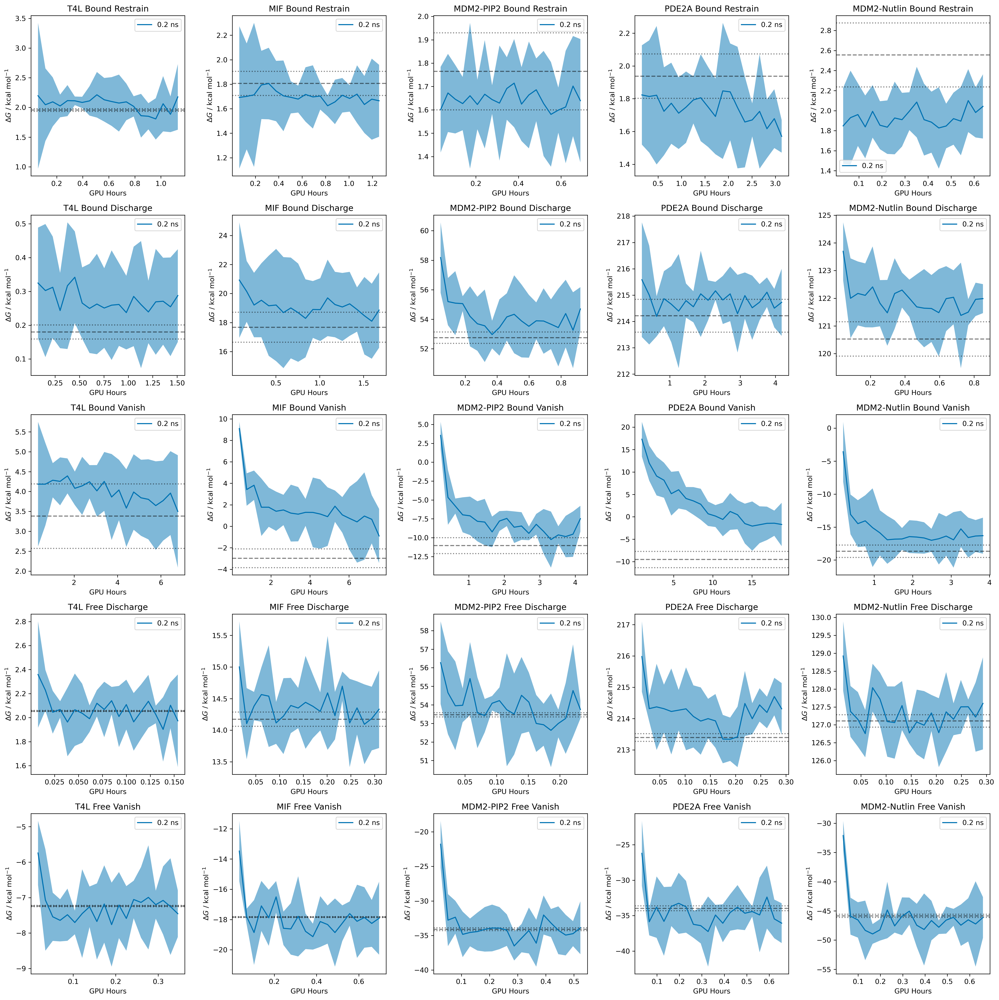

In [174]:
fig, axs = plot_dgs_conv_all(dgs_conv_nonequil, times = ["0.2 ns"], scale=False)
fig.savefig("dgs_conv_nonequil_02.png", bbox_inches="tight", dpi=600)


Always a trend to more negative free energies, as expected given equilibration.

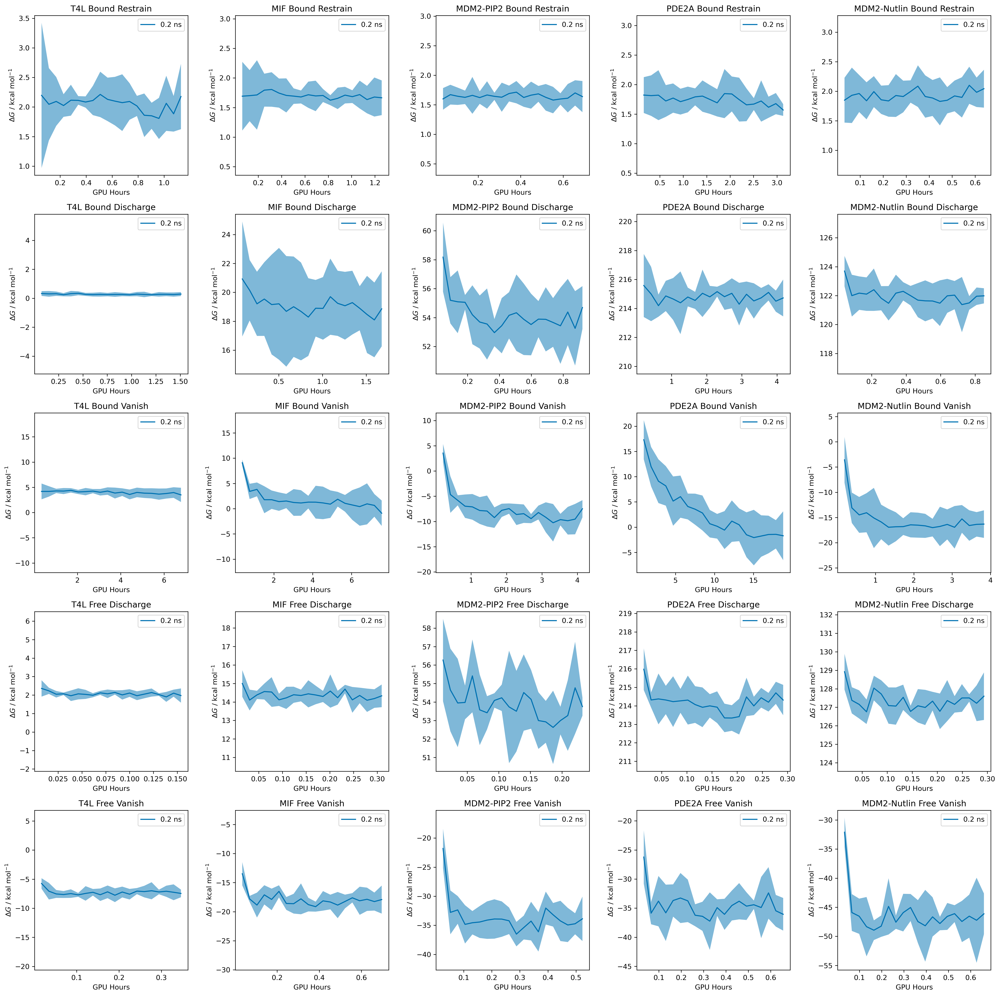

In [175]:
fig, axs = plot_dgs_conv_all(dgs_conv_nonequil, times = ["0.2 ns"], scale=True, show_final_dg=False)
fig.savefig("dgs_conv_nonequil_02_scaled.png", bbox_inches="tight", dpi=600)

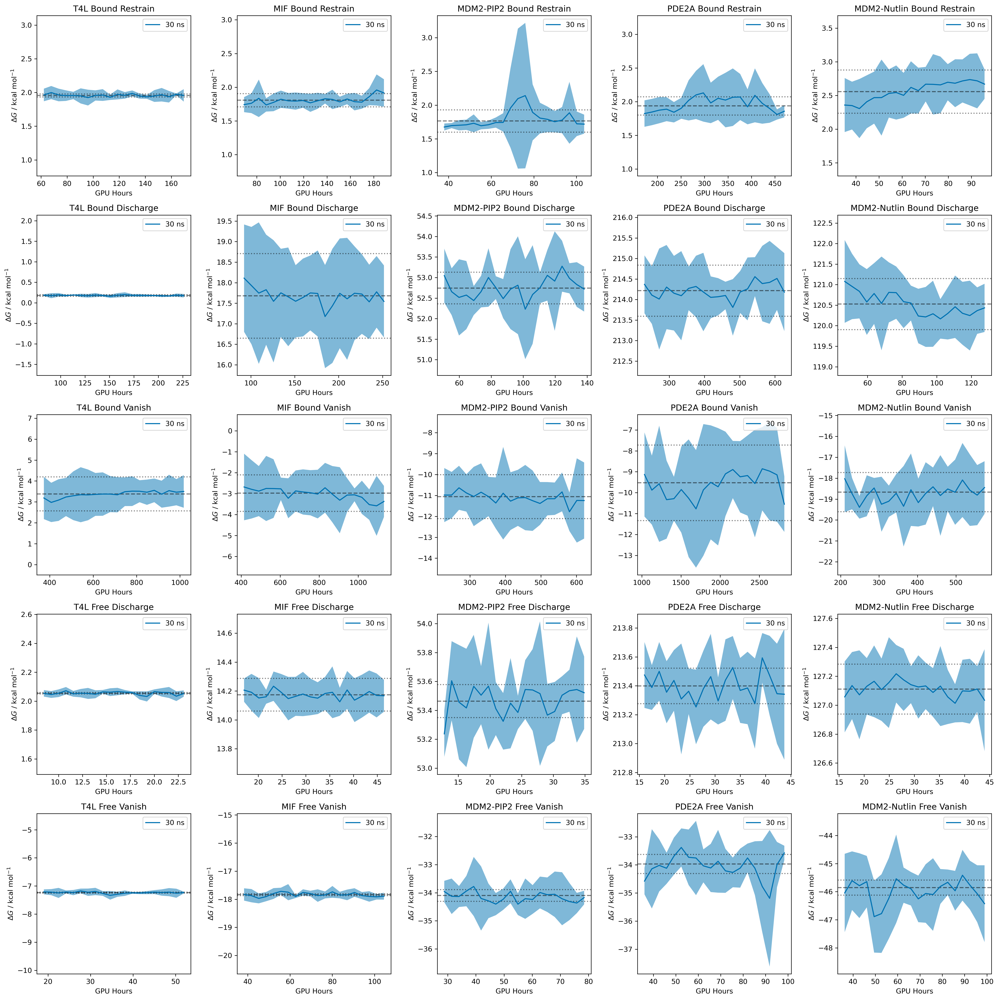

In [176]:
fig, axs = plot_dgs_conv_all(dgs_conv_equil, times = ["30 ns"], scale=True)
fig.savefig("dgs_conv_equil_30_scaled.png", bbox_inches="tight", dpi=600)

In [ ]:
# Get the restraint corrections for each system
restraint_corrections = {}
for lig in ligs:
    print(f"Analysing {lig}")
    calc = ee.Calculation(base_dir = calc_dirs[ligs[lig]["0.2 ns"]])
    restr_corr = calc.legs[0].restraints[0].getCorrection().value()
    restraint_corrections[lig] = restr_corr
    calc._close_logging_handlers()
    del(calc)

Analysing T4L
Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...
Analysing MIF
Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...
Analysing MDM2-Nutlin
Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...
Analysing MDM2-PIP2
Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...
Analysing PDE2A
Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...


In [102]:
# Get a dictionary of the final 30 ns results and uncertainties
with open("final_dGs_30.pkl", "rb") as f:
    final_dGs = pickle.load(f)

In [105]:
final_dGs

{'T4L': {'LegType.BOUND': {'StageType.RESTRAIN': 1.9565648,
   'StageType.DISCHARGE': 0.1798614,
   'StageType.VANISH': 3.3815818},
  'LegType.FREE': {'StageType.DISCHARGE': 2.0547764,
   'StageType.VANISH': -7.2368505999999995}},
 'MIF': {'LegType.BOUND': {'StageType.RESTRAIN': 1.8067608,
   'StageType.DISCHARGE': 17.6791064,
   'StageType.VANISH': -2.9755439999999997},
  'LegType.FREE': {'StageType.DISCHARGE': 14.173850000000002,
   'StageType.VANISH': -17.836250200000002}},
 'MDM2-PIP2': {'LegType.BOUND': {'StageType.RESTRAIN': 1.764849,
   'StageType.DISCHARGE': 52.7447342,
   'StageType.VANISH': -11.0555834},
  'LegType.FREE': {'StageType.DISCHARGE': 53.4640856,
   'StageType.VANISH': -34.0975538}},
 'PDE2A': {'LegType.BOUND': {'StageType.RESTRAIN': 1.937942,
   'StageType.DISCHARGE': 214.2162886,
   'StageType.VANISH': -9.528974999999999},
  'LegType.FREE': {'StageType.DISCHARGE': 213.39910099999997,
   'StageType.VANISH': -33.9675222}},
 'MDM2-Nutlin': {'LegType.BOUND': {'StageT

In [99]:
with open("restraint_corrections.pkl", "wb") as f:
    pickle.dump(restraint_corrections, f)

In [66]:
with open("restraint_corrections.pkl", "rb") as f:
    restraint_corrections = pickle.load(f)

In [64]:
# List the systems in the order we want them plotted
systems = ["T4L", "MIF", "MDM2-PIP2", "PDE2A", "MDM2-Nutlin"]

# Plot the convergence of the free energy changes for each stage for each leg for each time for each system
def plot_dgs_conv(ax: plt.axes, dgs: np.array, times: np.array, name: str, time:str) -> None:
    """Plot the convergence of the free energy changes for a on the given axis"""
    # Get the data for the given leg, stage, time and system
    # Calculate the 95 % CI with scipy
    mean_free_energy = np.mean(dgs, axis=0)
    conf_int = (
    t.interval(
        0.95,
        len(dgs) - 1,
        mean_free_energy,
        scale=sem(dgs),
    )[1]
    - mean_free_energy
    )  # 95 % C.I.
    # Plot lines showing the final free energy change and dotted lines at the 95 % CI
    final_dg, final_dg_err = final_dGs[name]["dg"]
    ax.axhline(final_dg, color="black", linestyle="--", alpha=0.5)
    ax.axhline(final_dg + final_dg_err, color="black", linestyle=":", alpha=0.5)
    ax.axhline(final_dg - final_dg_err, color="black", linestyle=":", alpha=0.5)
    # Plot the free energy changes against the simulation times
    ax.plot(times, mean_free_energy, label=f"{time}")
    # Fill between to show the 95 % CI
    ax.fill_between(times, mean_free_energy - conf_int, mean_free_energy + conf_int, alpha=0.5)
    # Label the plot
    ax.set_xlabel("GPU Hours")
    ax.set_ylabel(r"$\Delta G$ / kcal mol$^{-1}$")
    ax.set_title(name)
    ax.legend()
    plt.tight_layout()

def plot_dgs_conv_per_system(dg_dict: Dict, times = ["0.2 ns", "6 ns", "30 ns"], scale=False) -> Tuple[plt.Figure, plt.Axes]:
    """Plot the convergence of the free energy changes over the entire calculation for each system"""
    # Need 5 axes for the for each system
    n_systems = len(dg_dict)
    # Share y-axis scales along rows
    fig, axs = plt.subplots(1, n_systems, figsize=(4*n_systems, 4), dpi=600)
    axs = axs.flatten()
    for i, system in enumerate(systems):
        for time in times:
            n_times = len(dg_dict[system][time]["LegType.BOUND"]["StageType.DISCHARGE"]["dgs"][0])
            n_replicates = len(dg_dict[system][time]["LegType.BOUND"]["StageType.DISCHARGE"]["dgs"])
            dgs = np.zeros((n_replicates, n_times))
            times_data = np.zeros((n_times))
            for leg in dg_dict[system][time]:
                dg_multiplier = -1 if leg == "LegType.BOUND" else 1
                for stage in dg_dict[system][time][leg]:
                    dgs += np.array(dg_dict[system][time][leg][stage]["dgs"]) * dg_multiplier
                    times_data += np.array(dg_dict[system][time][leg][stage]["gpu_times"])
            dgs -= restraint_corrections[system]
            plot_dgs_conv(axs[i], dgs, times_data, system, time)
            

    if scale:
        # Set the y-axis scales to be the same within rows (same stages, different systems)
        # Get the largest difference between the upper and lower bounds of the y-axis
        y_diff = max([ax.get_ylim()[1] - ax.get_ylim()[0] for ax in axs])
        y_diff /=2
        for j in range(n_systems):
            # Set the y-axis limits to be the mean +/- half the difference
            ax_mean = np.mean(axs[j].get_ylim())
            axs[j].set_ylim(ax_mean - y_diff, ax_mean + y_diff)
        
    return fig, axs

(<Figure size 12000x2400 with 5 Axes>,
 array([<Axes: title={'center': 'T4L'}, xlabel='GPU Hours', ylabel='$\\Delta G$ / kcal mol$^{-1}$'>,
        <Axes: title={'center': 'MIF'}, xlabel='GPU Hours', ylabel='$\\Delta G$ / kcal mol$^{-1}$'>,
        <Axes: title={'center': 'MDM2-PIP2'}, xlabel='GPU Hours', ylabel='$\\Delta G$ / kcal mol$^{-1}$'>,
        <Axes: title={'center': 'PDE2A'}, xlabel='GPU Hours', ylabel='$\\Delta G$ / kcal mol$^{-1}$'>,
        <Axes: title={'center': 'MDM2-Nutlin'}, xlabel='GPU Hours', ylabel='$\\Delta G$ / kcal mol$^{-1}$'>],
       dtype=object))

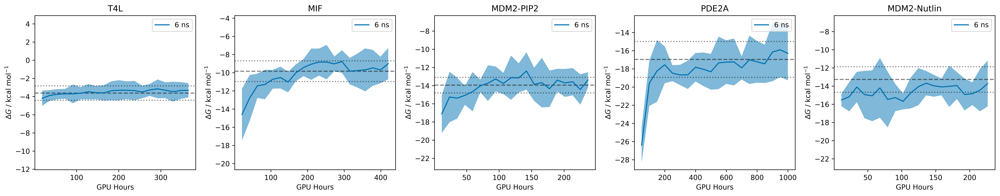

In [192]:
plot_dgs_conv_per_system(dgs_conv_nonequil, times = ["6 ns"],scale=True)

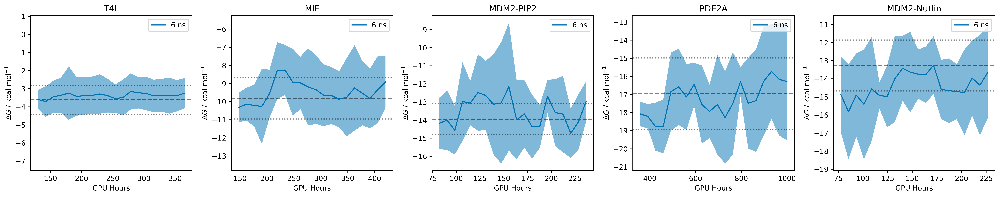

In [193]:
fig, ax = plot_dgs_conv_per_system(dgs_conv_equil, times = ["6 ns"],scale=True)
fig.savefig("dgs_overall_system_conv_equil_6_scaled.png", bbox_inches="tight", dpi=600)

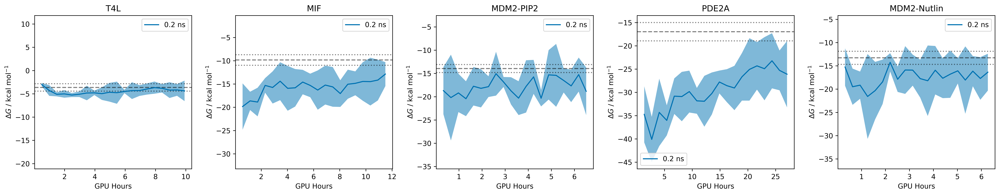

In [70]:
fig, axs = plot_dgs_conv_per_system(dgs_conv_equil, times = ["0.2 ns"],scale=True)
fig.savefig("dgs_overall_system_conv_equil_02_scaled.png", bbox_inches="tight", dpi=600)

In [195]:
# Get final combined free energy change and error
final_dg = 0
final_dg_err = 0
for system in final_dGs:
    final_dg += final_dGs[system]["dg"][0]
    final_dg_err += final_dGs[system]["dg"][1]**2
final_dg_err = np.sqrt(final_dg_err)

# Repeat above but combine all systems into one plot
def plot_dgs_conv_entire_dataset(dg_dict: Dict, times = ["0.2 ns", "6 ns", "30 ns"]) -> Tuple[plt.Figure, plt.Axes]:
    """Plot the convergence of the free energy changes over the entire dataset by combining data for all systems"""
    n_times = len(dg_dict["T4L"]["0.2 ns"]["LegType.BOUND"]["StageType.DISCHARGE"]["dgs"][0])
    n_replicates = len(dg_dict["T4L"]["0.2 ns"]["LegType.BOUND"]["StageType.DISCHARGE"]["dgs"])
    fig, ax = plt.subplots(figsize=(8, 4), dpi=600)
    for time in times:
        dgs = np.zeros((n_replicates, n_times)) 
        times = np.zeros((n_times))
        for system in dg_dict:
            for leg in dg_dict[system][time]:
                dg_multiplier = -1 if leg == "LegType.BOUND" else 1
                for stage in dg_dict[system][time][leg]:
                    dgs += np.array(dg_dict[system][time][leg][stage]["dgs"]) * dg_multiplier
                    times += np.array(dg_dict[system][time][leg][stage]["gpu_times"]) * len(dg_dict[system][time][leg][stage]["dgs"])
            dgs -= restraint_corrections[system]
        # Get the mean free energies and 95 % CIs
        mean_free_energy = np.mean(dgs, axis=0)
        conf_int = (
        t.interval(
            0.95,
            len(dgs) - 1,
            mean_free_energy,
            scale=sem(dgs),
        )[1]
        - mean_free_energy
        )
        # Plot the free energy changes against the simulation times
        ax.plot(times, mean_free_energy, label=f"{time}")
        # Fill between to show the 95 % CI
        ax.fill_between(times, mean_free_energy - conf_int, mean_free_energy + conf_int, alpha=0.5)
        # Label the plot
        ax.set_xlabel("GPU Hours")
        ax.set_ylabel(r"Combined $\Delta G^o_\mathrm{Bind}$ / kcal mol$^{-1}$")

    plt.tight_layout()
    ax.legend()

    return fig, ax


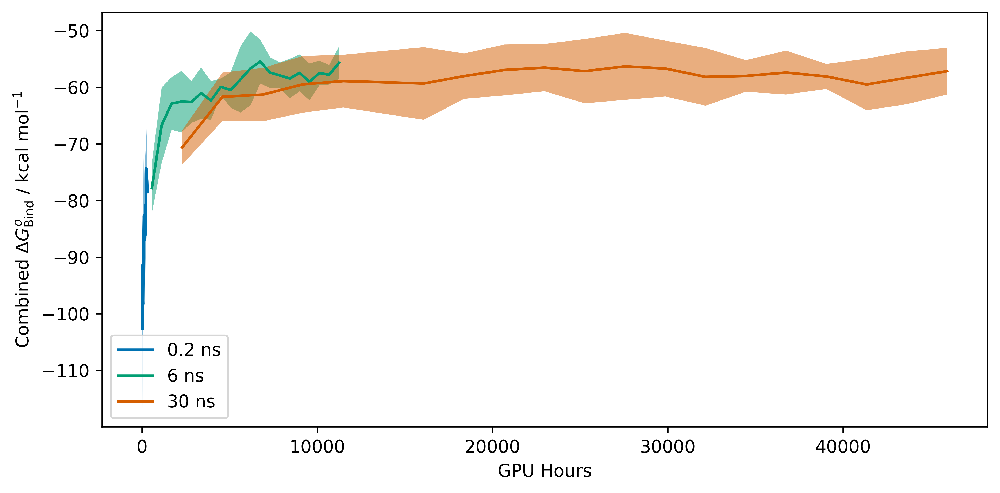

In [196]:
fig, ax = plot_dgs_conv_entire_dataset(dgs_conv_nonequil)

### Plot Change in 95 % CIs

In [30]:
# List the systems in the order we want them plotted
systems = ["T4L", "MIF", "MDM2-PIP2", "PDE2A", "MDM2-Nutlin"]

# Plot the convergence of the free energy changes for each stage for each leg for each time for each system
def plot_cis_conv(ax: plt.axes, dg_dict: Dict, leg: str, stage: str, time: str, system: str, flatten:bool=False) -> None:
    """Plot the change in the confidence intervals of the free energy changes for a given leg, stage, time and system"""
    # Get the data for the given leg, stage, time and system
    data = dg_dict[system][time][leg][stage]
    # Get the simulation times
    times = data["gpu_times"]
    # Get the free energy changes
    dgs = np.array(data["dgs"])
    # Get cumulative average of the free energy changes
    cum_dgs = np.cumsum(dgs, axis=1) / np.arange(1, len(dgs[0]) + 1)
    # Calculate the 95 % CI with scipy
    mean_free_energy = np.mean(cum_dgs, axis=0)
    conf_int = t.interval(
        0.95,
        len(cum_dgs) - 1,
        mean_free_energy,
        scale=sem(cum_dgs),
    )[1] - mean_free_energy # 95 % C.I.
    # Multiply the confidence intervals by sqrt(cumulative simulation time) to get the 95 % CI of the thermodynamic length
    if flatten:
        delta_t = times[1] - times[0]
        cum_times = times - (times[0] - delta_t)
        conf_int *= np.sqrt(cum_times)
        # Plot line of best fit and display gradient and R^2
        slope, intercept, r_value, p_value, std_err = linregress(times, conf_int)
        ax.plot(times, slope * times + intercept, color="black", linestyle="--")
        ax.text(0.40, 0.1, f"R$^2$ = {r_value**2:.2f}", transform=ax.transAxes)
        ax.text(0.40, 0.05, f"Gradient = {slope:.3f}", transform=ax.transAxes)

    # Plot the confidence intervals against the simulation times
    ax.plot(times, conf_int, label=f"{time}")
    # Label the plot
    ax.set_xlabel("GPU Hours")
    if flatten:
        ax.set_ylabel(r"$\sqrt{t_\mathrm{Sample}}$ * 95 % C.I. of $\Delta G$" + "\n" + r"/ kcal mol$^{-1}$ ns$^{\frac{1}{2}}$")
    else:
        ax.set_ylabel(r"95 % C.I. of $\Delta G$ / kcal mol$^{-1}$")
    stage_str = stage.split(".")[1].capitalize()
    leg_str = leg.split(".")[1].capitalize()
    # Ensure that the lower y limit is always 0
    ax.set_ylim(bottom=0)
    ax.set_title(f"{system} {leg_str} {stage_str}")
    #ax.legend()
    plt.tight_layout()

def plot_cis_conv_all(dg_dict: Dict, times = ["0.2 ns", "6 ns", "30 ns"], scale=False, flatten=False) -> Tuple[plt.Figure, plt.Axes]:
    """Plot the convergence of the free energy changes for each stage for each leg for each time for each system"""
    # Need 5 axes for the for each system
    n_systems = len(dg_dict)
    # Share y-axis scales along rows
    fig, axs = plt.subplots(5, n_systems, figsize=(4*5, 4*n_systems), dpi=300)
    for i, system in enumerate(systems):
        for time in times:
            ax_ind = 0
            for j, leg in enumerate(dg_dict[system][time]):
                for k, stage in enumerate(dg_dict[system][time][leg]):
                    plot_cis_conv(axs[ax_ind, i], dg_dict, leg, stage, time, system, flatten=flatten)
                    ax_ind += 1

    if scale:
        # Set the y-axis scales to be the same within rows (same stages, different systems)
        for i in range(5):
            # Get the largest difference between the upper and lower bounds of the y-axis
            y_diff = max([ax.get_ylim()[1] - ax.get_ylim()[0] for ax in axs[i, :]])
            y_diff /=2
            for j in range(n_systems):
                # Set the y-axis limits to be the mean +/- half the difference
                ax_mean = np.mean(axs[i, j].get_ylim())
                axs[i, j].set_ylim(ax_mean - y_diff, ax_mean + y_diff)
        
    return fig, axs

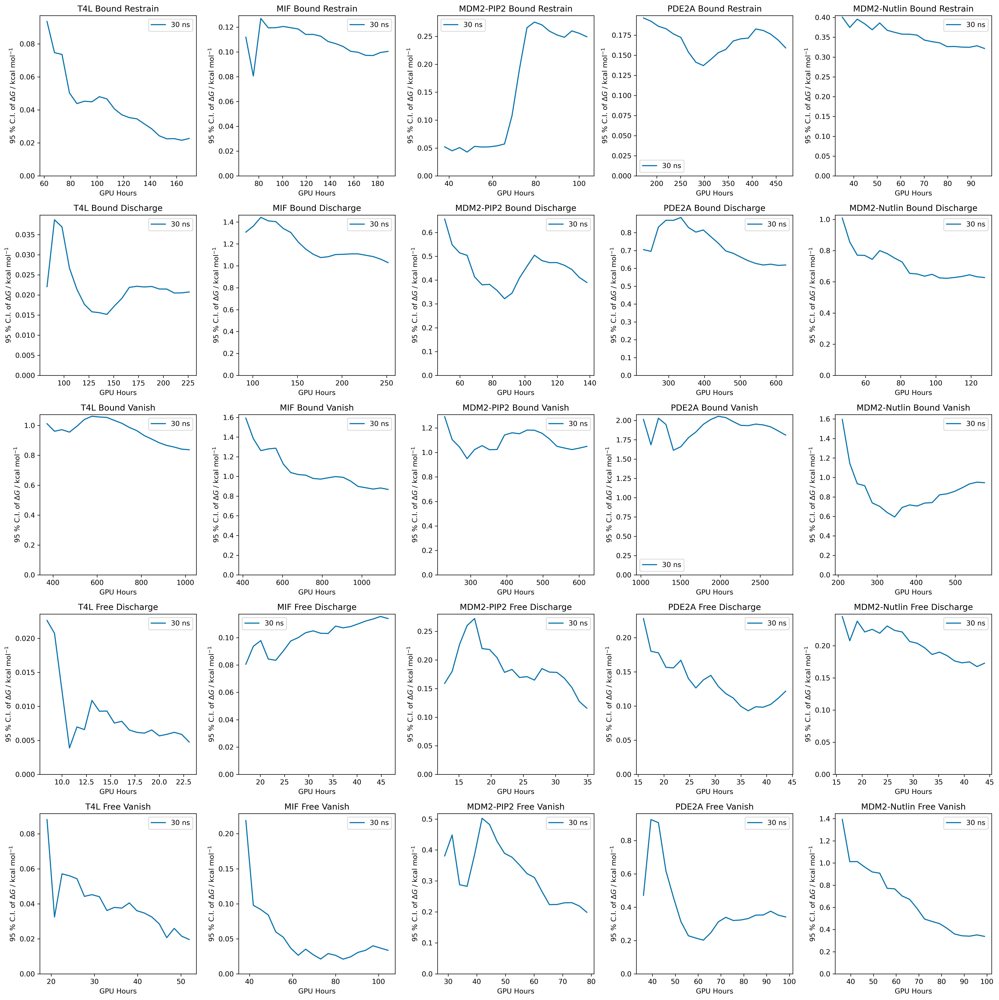

In [15]:
fig, ax = plot_cis_conv_all(dgs_conv_equil, flatten=False, times=["30 ns"])
fig.savefig("cis_conv_equil_30ns.png", bbox_inches="tight", dpi=600)

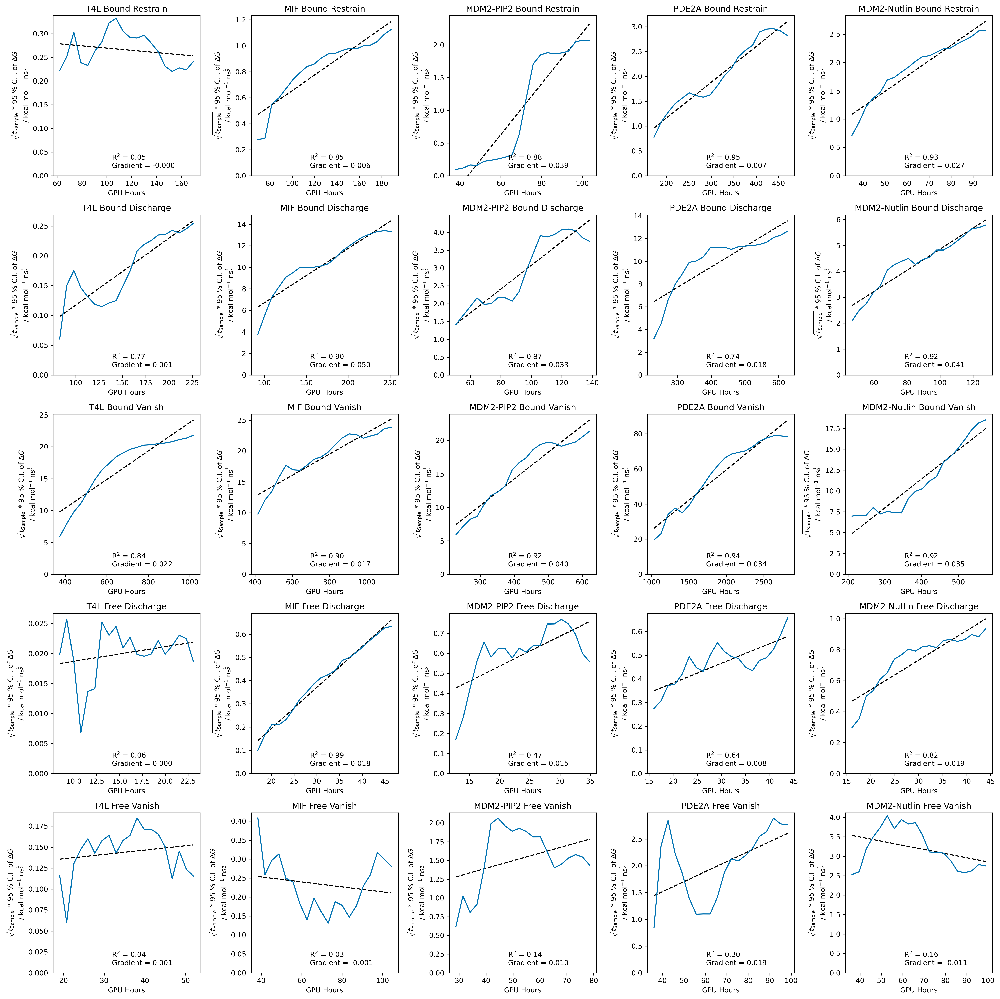

In [31]:
fig, ax = plot_cis_conv_all(dgs_conv_equil, flatten=True, times=["30 ns"])
fig.savefig("cis_conv_equil_30ns_flattened.png", bbox_inches="tight", dpi=600)

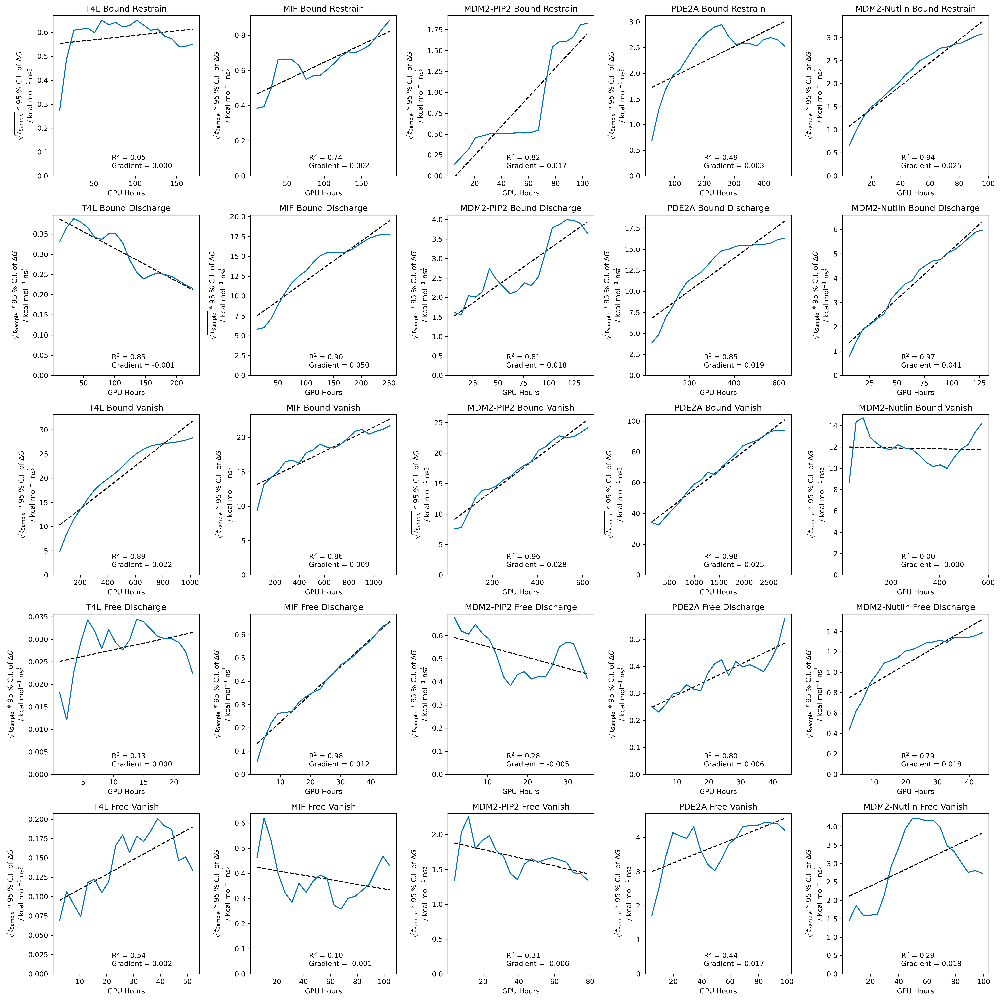

In [32]:
fig, ax = plot_cis_conv_all(dgs_conv_nonequil, flatten=True, times=["30 ns"])

In [20]:
def plot_cis_conv(ax: plt.axes, dgs: np.array, times: np.array, name: str, time:str, flatten:bool=False) -> None:
    """Plot the change in the confidence intervals of the free energy changes for a given leg, stage, time and system"""
    # Get the data for the given leg, stage, time and system
    # Get cumulative average of the free energy changes
    cum_dgs = np.cumsum(dgs, axis=1) / np.arange(1, len(dgs[0]) + 1)
    # Calculate the 95 % CI with scipy
    mean_free_energy = np.mean(cum_dgs, axis=0)
    conf_int = t.interval(
        0.95,
        len(cum_dgs) - 1,
        mean_free_energy,
        scale=sem(cum_dgs),
    )[1] - mean_free_energy # 95 % C.I.
    # Multiply the confidence intervals by sqrt(cumulative simulation time) to get the 95 % CI of the thermodynamic length
    if flatten:
        delta_t = times[1] - times[0]
        cum_times = times - (times[0] - delta_t)
        conf_int *= np.sqrt(cum_times)
        # Plot line of best fit and display gradient and R^2
        slope, intercept, r_value, p_value, std_err = linregress(times, conf_int)
        ax.plot(times, slope * times + intercept, color="black", linestyle="--")
        ax.text(0.40, 0.1, f"R$^2$ = {r_value**2:.2f}", transform=ax.transAxes)
        ax.text(0.40, 0.05, f"Gradient = {slope:.3f}", transform=ax.transAxes)

    # Plot the confidence intervals against the simulation times
    ax.plot(times, conf_int, label=f"{time}")
    # Label the plot
    ax.set_xlabel("GPU Hours")
    if flatten:
        ax.set_ylabel(r"$\sqrt{t_\mathrm{Sample}}$ * 95 % C.I. of $\Delta G$" + "\n" + r"/ kcal mol$^{-1}$ ns$^{\frac{1}{2}}$")
    else:
        ax.set_ylabel(r"95 % C.I. of $\Delta G$ / kcal mol$^{-1}$")
    ax.set_title(name)
    # Set the lower limit of the y-axis to 0 without chaning the upper limit
    ax.legend()
        
# Plot the combined confidence intervals for each system
def plot_cis_conv_per_system(dg_dict: Dict, times = ["0.2 ns", "6 ns", "30 ns"], flatten=False) -> Tuple[plt.Figure, plt.Axes]:
    """Plot the convergence of the free energy changes over the entire calculation for each system"""
    # Need 5 axes for the for each system
    n_systems = len(dg_dict)
    # Share y-axis scales along rows and ensure that minimum of y is 0
    fig, axs = plt.subplots(1, n_systems, figsize=(4*n_systems, 4), dpi=600, sharey=True)
    axs = axs.flatten()
    for i, system in enumerate(systems):
        for time in times:
            n_times = len(dg_dict[system][time]["LegType.BOUND"]["StageType.DISCHARGE"]["dgs"][0])
            n_replicates = len(dg_dict[system][time]["LegType.BOUND"]["StageType.DISCHARGE"]["dgs"])
            dgs = np.zeros((n_replicates, n_times))
            times_data = np.zeros((n_times))
            for leg in dg_dict[system][time]:
                dg_multiplier = -1 if leg == "LegType.BOUND" else 1
                for stage in dg_dict[system][time][leg]:
                    dgs += np.array(dg_dict[system][time][leg][stage]["dgs"]) * dg_multiplier
                    times_data += np.array(dg_dict[system][time][leg][stage]["gpu_times"])
            plot_cis_conv(axs[i], dgs, times_data, system, time, flatten=flatten)
            
    axs[0].set_ylim(bottom=0)
    fig.tight_layout()
    return fig, axs


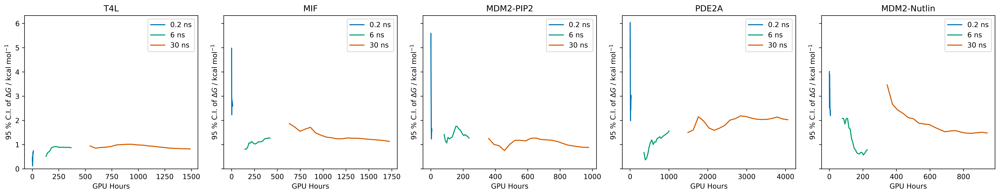

In [34]:
fig, ax = plot_cis_conv_per_system(dgs_conv_equil, flatten=False)
fig.savefig("cis_overall_system_conv_equil.png", bbox_inches="tight", dpi=600)

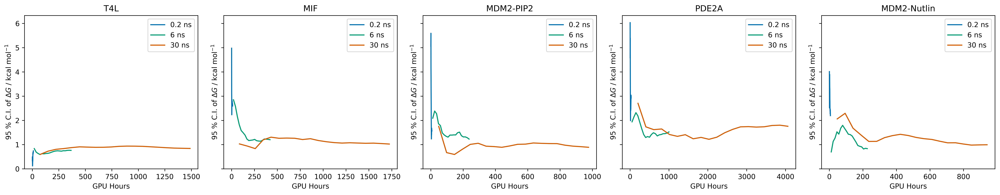

In [35]:
fig, ax = plot_cis_conv_per_system(dgs_conv_nonequil, flatten=False)
fig.savefig("cis_overall_system_conv_nonequil.png", bbox_inches="tight", dpi=600)

In [29]:
# Plot the combined confidence intervals for each system
def plot_cis_conv_entire_dataset(dg_dict: Dict, times = ["0.2 ns", "6 ns", "30 ns"], flatten=False) -> Tuple[plt.Figure, plt.Axes]:
    """Plot the convergence of the free energy changes over the entire dataset by combining data for all systems"""
    n_times = len(dg_dict["T4L"]["0.2 ns"]["LegType.BOUND"]["StageType.DISCHARGE"]["dgs"][0])
    n_replicates = len(dg_dict["T4L"]["0.2 ns"]["LegType.BOUND"]["StageType.DISCHARGE"]["dgs"])
    fig, ax = plt.subplots(figsize=(8, 4), dpi=600)
    for time in times:
        dgs = np.zeros((n_replicates, n_times)) 
        times = np.zeros((n_times))
        for system in dg_dict:
            for leg in dg_dict[system][time]:
                dg_multiplier = -1 if leg == "LegType.BOUND" else 1
                for stage in dg_dict[system][time][leg]:
                    dgs += np.array(dg_dict[system][time][leg][stage]["dgs"]) * dg_multiplier
                    times += np.array(dg_dict[system][time][leg][stage]["gpu_times"]) * len(dg_dict[system][time][leg][stage]["dgs"])
        # Get cumulative average of the free energy changes
        cum_dgs = np.cumsum(dgs, axis=1) / np.arange(1, len(dgs[0]) + 1)
        # Calculate the 95 % CI with scipy
        mean_free_energy = np.mean(cum_dgs, axis=0)
        conf_int = t.interval(
            0.95,
            len(cum_dgs) - 1,
            mean_free_energy,
            scale=sem(cum_dgs),
        )[1] - mean_free_energy # 95 % C.I.
        # Plot results
        ax.plot(times, conf_int, label=f"{time}")
        # Label the plot
        ax.set_xlabel("GPU Hours")
        if flatten:
            ax.set_ylabel(r"$\sqrt{t_\mathrm{Sample}}$ * 95 % C.I. of $\Delta G$" + "\n" + r"/ kcal mol$^{-1}$ ns$^{\frac{1}{2}}$")
        else:
            ax.set_ylabel(r"95 % C.I. of $\Delta G$ / kcal mol$^{-1}$")
        # Ensure that the lower y limit is always 0
        ax.set_ylim(bottom=0)
        ax.legend()

        # Multiply the confidence intervals by sqrt(cumulative simulation time) to get the 95 % CI of the thermodynamic length
        if flatten:
            delta_t = times[1] - times[0]
            cum_times = times - (times[0] - delta_t)
            conf_int *= np.sqrt(cum_times)
            # Plot line of best fit and display gradient and R^2
            slope, intercept, r_value, p_value, std_err = linregress(times, conf_int)
            ax.plot(times, slope * times + intercept, color="black", linestyle="--")


        fig.tight_layout()
    return fig, ax


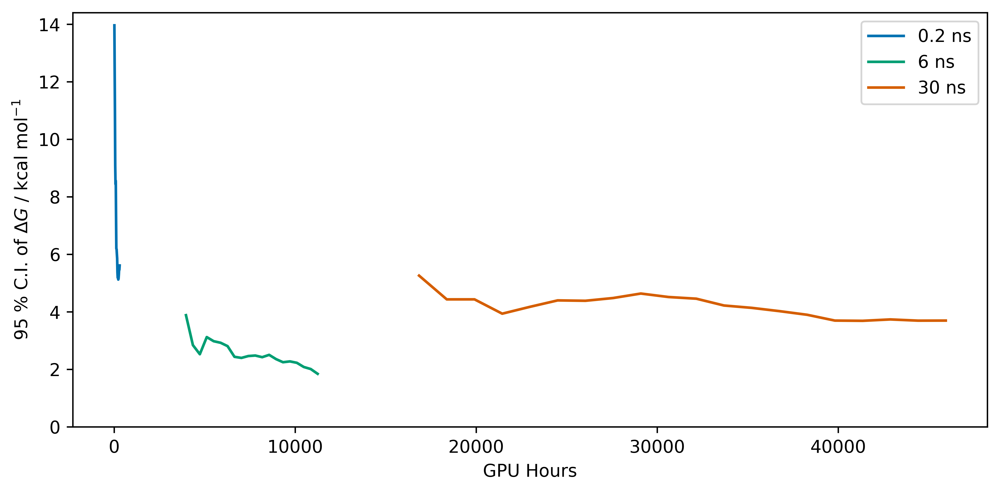

In [30]:
fig, ax = plot_cis_conv_entire_dataset(dgs_conv_equil, flatten=False)
fig.savefig("cis_conv_equil_entire.png", bbox_inches="tight", dpi=600)

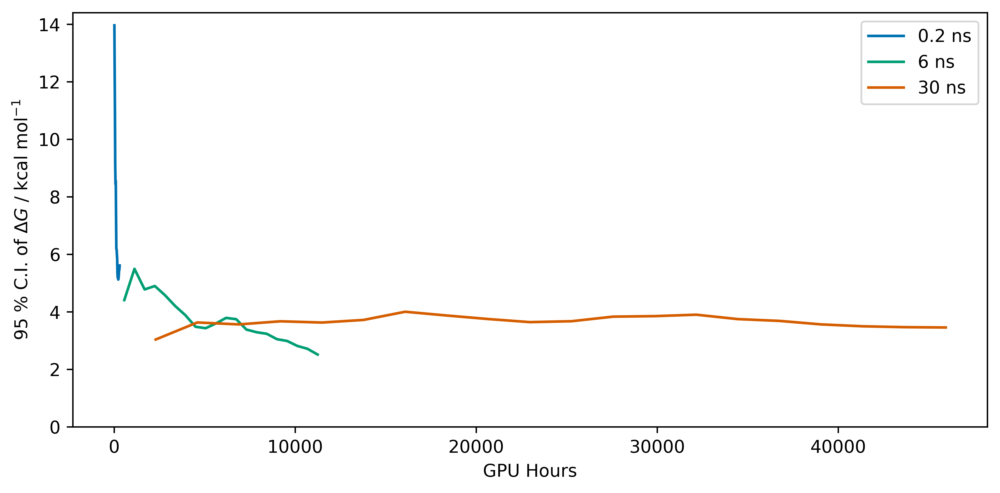

In [33]:
fig, ax = plot_cis_conv_entire_dataset(dgs_conv_nonequil, flatten=False)
fig.savefig("cis_conv_nonequil_entire.png", bbox_inches="tight", dpi=600)

# Finally, Check for Signficant Differences Between the Free Energies from the 0.2 ns, 6 ns, and 30 ns Runs for each system

In [48]:
import EnsEquil as ee
import pickle

# Dict mapping directory names to calculation names
calc_dirs = {
    "t4l_0.2": "t4l_200ps",
    "t4l_6": "t4l_5000ps",
    "t4l_30": "t4l_30000ps",
    "mif_0.2": "mif_180_anti_200ps",
    "mif_6": "mif_180_anti_5000ps",
    "mif_30": "mif_180_anti_30000ps",
    "mdm2_nut_0.2": "mdm2_nutlin_single_pose_200ps",
    "mdm2_nut_6": "mdm2_nutlin_single_pose_5000ps",
    "mdm2_nut_30": "mdm2_nutlin_single_pose_30000ps",
    "mdm2_pip_0.2": "mdm2_pip2_short_200ps",
    "mdm2_pip_6": "mdm2_pip2_short_5000ps",
    "mdm2_pip_30": "mdm2_pip2_short_30000ps",
    "pde_0.2": "pde2a_p10_200ps",
    "pde_6": "pde2a_p10_5000ps",
    "pde_30": "pde2a_p10_30000",
}


ligs = {
    "T4L": {"0.2 ns": "t4l_0.2", "6 ns": "t4l_6", "30 ns": "t4l_30"},
    "MIF": {"0.2 ns": "mif_0.2", "6 ns": "mif_6", "30 ns": "mif_30"},
    "MDM2-Nutlin": {"0.2 ns": "mdm2_nut_0.2", "6 ns": "mdm2_nut_6", "30 ns": "mdm2_nut_30"},
    "MDM2-PIP2": {"0.2 ns": "mdm2_pip_0.2", "6 ns": "mdm2_pip_6", "30 ns": "mdm2_pip_30"},
    "PDE2A": {"0.2 ns": "pde_0.2", "6 ns": "pde_6", "30 ns": "pde_30"},
}
# Get dictionary of final free energy changes for the 30 ns runs
final_dGs_all = {}
for system in ligs:
    final_dGs_all[system] = {}
    for time in ligs["T4L"]:
        print(f"Analysing {system} {time}")
        calc = ee.Calculation(base_dir=calc_dirs[ligs[system][time]])
        calc.recursively_set_attr("relative_simulation_cost", 1, force=True)
        if calc._delta_g is None:
            calc.analyse()
        final_dGs_all[system][time] = {}
        final_dGs_all[system][time]["dgs"] = calc._delta_g
        for leg in calc.legs:
            final_dGs_all[system][time][str(leg.leg_type)] = {}
            final_dGs_all[system][time][str(leg.leg_type)]["dg"] = leg._delta_g
            for stage in leg.stages:
                final_dGs_all[system][time][str(leg.leg_type)][str(stage.stage_type)] = {}
                final_dGs_all[system][time][str(leg.leg_type)][str(stage.stage_type)]["dg"] = stage._delta_g
        calc._dump()
        calc._close_logging_handlers()
        del(calc)

        with open("final_dGs_all.pkl", "wb") as f:
            pickle.dump(final_dGs_all, f)

Analysing T4L 0.2 ns
Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...
Analysing T4L 6 ns
Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...
Analysing T4L 30 ns
Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...
Analysing MIF 0.2 ns
Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...
Analysing MIF 6 ns
Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...
Analysing MIF 30 ns
Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...
Analysing MDM2-Nutlin 0.2 ns
Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...
Analysing MDM2-Nutlin 6 ns
Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...
Analysing MDM2-Nutlin 30 ns
Loading previous Calculation. Any arguments will be overwritten...
Setting up loggin

In [4]:
with open("final_dGs_all.pkl", "rb") as f:
    final_dGs_all = pickle.load(f)

In [36]:
final_dGs_all["T4L"]["0.2 ns"]

{'dgs': array([-4.52600492, -4.93372192, -3.70116092, -4.89255392, -3.61151592]),
 'LegType.BOUND': {'dg': array([-0.36931308, -0.34075608, -1.41067908, -0.16056208, -1.42280808]),
  'StageType.RESTRAIN': {'dg': array([2.074448, 2.025605, 1.828114, 2.121106, 2.116384])},
  'StageType.DISCHARGE': {'dg': array([0.21543 , 0.28987 , 0.133874, 0.342176, 0.389002])},
  'StageType.VANISH': {'dg': array([4.424163, 4.427123, 3.710687, 4.45951 , 3.15516 ])}},
 'LegType.FREE': {'dg': array([-4.895318, -5.274478, -5.11184 , -5.053116, -5.034324]),
  'StageType.DISCHARGE': {'dg': array([2.039971, 2.087112, 2.082629, 2.077735, 2.040826])},
  'StageType.VANISH': {'dg': array([-6.935289, -7.36159 , -7.194469, -7.130851, -7.07515 ])}}}

In [46]:
# Function to check run non-parametric ANOVA between all times for a given system, leg and stage
def check_kruskal(system: str, leg: str, stage: str, dg_dict: Dict) -> None:
    """Check whether the free energy changes for a given system, leg and stage are significantly different between the three times"""
    # Get the data for the given leg, stage, and system, for all times
    times = ["0.2 ns", "6 ns", "30 ns"]
    data = []
    for time in times:
        data.append(dg_dict[system][time][leg][stage]["dg"])

    # Perform Kruskal-Wallis test
    f, p = kruskal(*data)
    return p


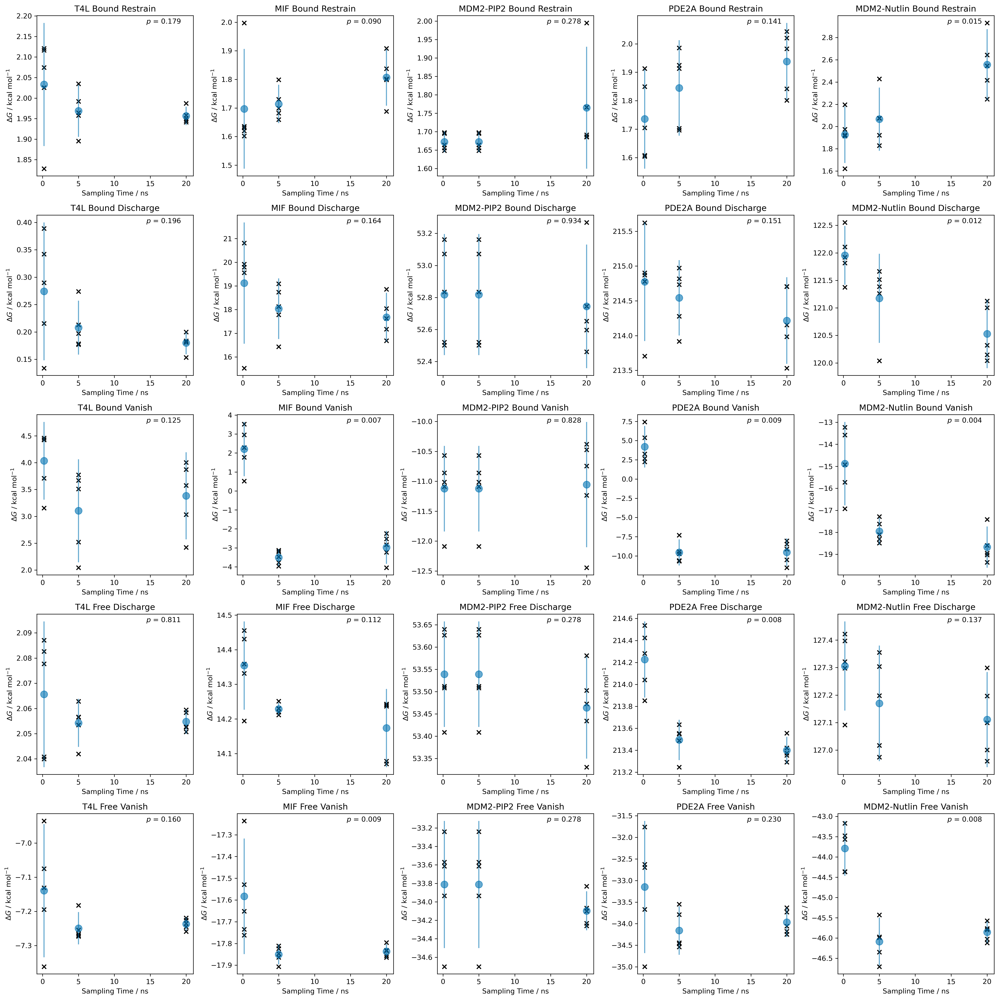

In [92]:
# For each stage for each leg for each system, plot boxplots of the free energy changes for each time
def plot_dgs_diffs(dg_dict: Dict, times = ["0.2 ns", "6 ns", "30 ns"]) -> Tuple[plt.Figure, plt.Axes]:
    """Plot the free energy changes for each time for each system"""
    # Need 5 axes for the for each system
    n_systems = len(dg_dict)
    sampling_times = [0.2, 5, 20] # Discounting equilibration
    # Share y-axis scales along rows
    fig, axs = plt.subplots(5, n_systems, figsize=(4*5, 4*n_systems), dpi=300)
    for i, system in enumerate(systems):
        ax_ind = 0
        for j, leg in enumerate(["LegType.BOUND", "LegType.FREE"]):
            stages = ["StageType.DISCHARGE", "StageType.VANISH"]
            if leg == "LegType.BOUND":
                # append to start of list
                stages.insert(0, "StageType.RESTRAIN")
            for k, stage in enumerate(stages):
                dgs_list = []
                mean_dgs = []
                cis = []
                for time in times:
                    dgs = dg_dict[system][time][leg][stage]["dg"]
                    dgs_list.append(dgs)
                    mean_dg = np.mean(dgs)
                    mean_dgs.append(mean_dg)
                    ci = t.interval(
                        0.95,
                        len(dgs) - 1,
                        mean_dg,
                        scale=sem(dgs),
                    )[1] - mean_dg
                    cis.append(ci)
                # Make the marker large
                axs[ax_ind, i].errorbar(sampling_times, mean_dgs, yerr=cis, fmt="o", markersize=10, alpha=0.6)
                # Also scatter vertical dots for each free energy change at a given time
                for k,time in enumerate(sampling_times):
                    axs[ax_ind, i].scatter([time]*len(dgs_list[k]), dgs_list[k], color="black", marker="x")
                # Get the Kruskal-Wallace stat and add to plots
                p = check_kruskal(system, leg, stage, dg_dict)
                axs[ax_ind, i].text(0.7, 0.95, f"$p$ = {p:.3f}", transform=axs[ax_ind, i].transAxes)
                stage_str = stage.split(".")[1].capitalize()
                leg_str = leg.split(".")[1].capitalize()
                #axs[ax_ind, i].boxplot(data, labels=times)
                axs[ax_ind, i].set_title(f"{system} {leg_str} {stage_str}")
                axs[ax_ind, i].set_xlabel("Sampling Time / ns")
                axs[ax_ind, i].set_ylabel(r"$\Delta G$ / kcal mol$^{-1}$")
                ax_ind += 1

    fig.tight_layout()
    return fig, axs

fig, axs = plot_dgs_diffs(final_dGs_all)
fig.savefig("dg_diffs_times.png", bbox_inches="tight", dpi=600)

## T-test system-wise differences between different times and check for overall significance of differences

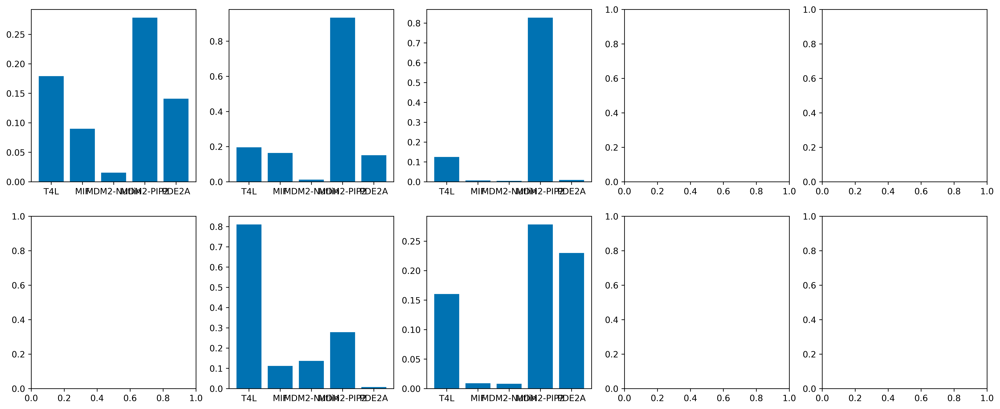

In [93]:
# Now plot Kruskal-Wallis p-values for all stages for all legs
fig, axs = plt.subplots(2, 5, figsize=(4*5, 4*2), dpi=600)
for i, leg in enumerate(["LegType.BOUND", "LegType.FREE"]):
    stages = ["StageType.RESTRAIN", "StageType.DISCHARGE", "StageType.VANISH"]
    for j, stage in enumerate(stages):
        if leg == "LegType.FREE" and stage == "StageType.RESTRAIN":
            continue
        p_values = []
        for lig in ligs:
            p_values.append(check_kruskal(lig, leg, stage, final_dGs_all))
        axs[i, j].bar(ligs.keys(), p_values, label=f"{leg} {stage}")

In [ ]:
# Function to check for significant differences using scikit-posthocs critical difference diagram
def plot_difference_diagram(ax: plt.axes, dgs: np.array, names: List[str], system: str, time: str) -> None:
    """Plot the critical difference diagram for the given free energy changes"""
    # Calculate the critical difference diagram
    cd = sp.posthoc_nemenyi_friedman(dgs.T)
    # Plot the critical difference diagram
    sp.sign_plot(cd, ax=ax, names=names, line_offset=0.1, line_height=0.1, text_offset=0.2, text_format="0.2f")
    # Label the plot
    ax.set_title(f"{system} {time}")
    ax.set_xlabel(r"$\Delta G$ / kcal mol$^{-1}$")
    plt.tight_layout()

╭─────────────────────────────── Traceback (most recent call last) ────────────────────────────────╮
│ in <module>                                                                                      │
│                                                                                                  │
│   1 fig, ax = plt.subplots(figsize=(8, 4), dpi=300)                                              │
│ ❱ 2 plot_dgs_conv_all(ax, dgs_conv_equil, "LegType.BOUND", "StageType.RESTRAIN", "0.2 ns", e     │
│   3                                                                                              │
│                                                                                                  │
│ in plot_dgs_conv_all                                                                             │
│                                                                                                  │
│    9 │   │   # Get the free energy changes                                                       │
│   10 │   │   dgs = data["dgs"]                                                                   │
│   11 │   │   # Plot the free energy changes against the simulation times                         │
│ ❱ 12 │   │   ax.plot(times, dgs, label=f"{system}")                                              │
│   13 │   # Label the plot                                                                        │
│   14 │   ax.set_xlabel("Simulation Time / ns")                                                   │
│   15 │   ax.set_ylabel(r"$\Delta G$ / kcal mol$^{-1}$")                                          │
│                                                                                                  │
│ /home/finlayclark/anaconda3/envs/mamba/envs/ensequil/lib/python3.9/site-packages/matplotlib/axes │
│ /_axes.py:1688 in plot                                                                           │
│                                                                                                  │
│   1685 │   │   (``'green'``) or hex strings (``'#008000'``).                                     │
│   1686 │   │   """                                                                               │
│   1687 │   │   kwargs = cbook.normalize_kwargs(kwargs, mlines.Line2D)                            │
│ ❱ 1688 │   │   lines = [*self._get_lines(*args, data=data, **kwargs)]                            │
│   1689 │   │   for line in lines:                                                                │
│   1690 │   │   │   self.add_line(line)                                                           │
│   1691 │   │   if scalex:                                                                        │
│                                                                                                  │
│ /home/finlayclark/anaconda3/envs/mamba/envs/ensequil/lib/python3.9/site-packages/matplotlib/axes │
│ /_base.py:311 in __call__                                                                        │
│                                                                                                  │
│    308 │   │   │   if args and isinstance(args[0], str):                                         │
│    309 │   │   │   │   this += args[0],                                                          │
│    310 │   │   │   │   args = args[1:]                                                           │
│ ❱  311 │   │   │   yield from self._plot_args(                                                   │
│    312 │   │   │   │   this, kwargs, ambiguous_fmt_datakey=ambiguous_fmt_datakey)                │
│    313 │                                                                                         │
│    314 │   def get_next_color(self):                                                             │
│                                                                                                  │
│ /home/finlayclark/anaconda3/envs/mamba/envs/ensequil/lib/py

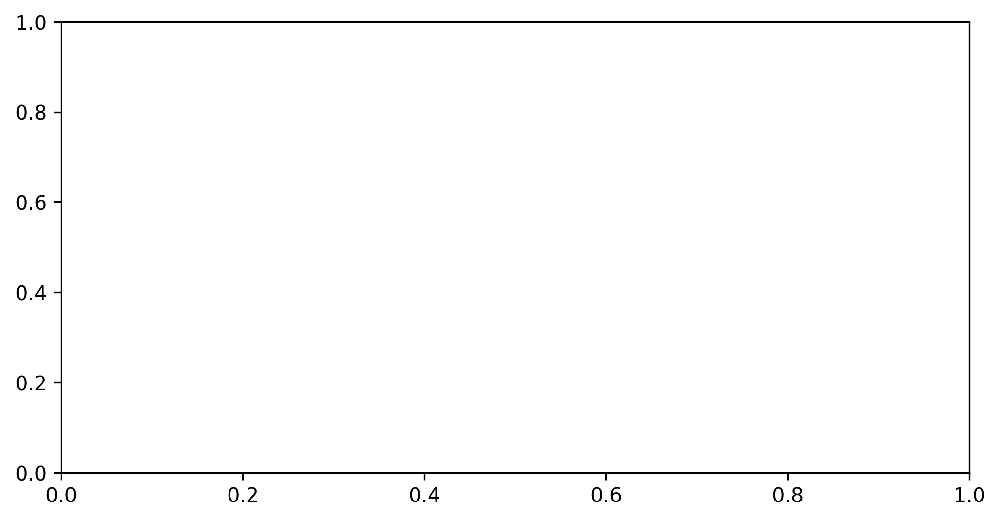

In [20]:
fig, ax = plt.subplots(figsize=(8, 4), dpi=300)
plot_dgs_conv_all(ax, dgs_conv_equil, "LegType.BOUND", "StageType.RESTRAIN", "0.2 ns", equil=True)

In [35]:
calc = ee.Calculation(base_dir = calc_dirs[ligs["T4L"]["30 ns"]])

Loading previous Calculation. Any arguments will be overwritten...
Setting up logging...


In [36]:
calc.tot_simtime

╭─────────────────────────────── Traceback (most recent call last) ────────────────────────────────╮
│ in <module>                                                                                      │
│                                                                                                  │
│ ❱ 1 calc.tot_simtime                                                                             │
│   2                                                                                              │
│                                                                                                  │
│ /home/finlayclark/software/devel/EnsEquil/EnsEquil/run/_simulation_runner.py:671 in tot_simtime  │
│                                                                                                  │
│    668 │   def tot_simtime(self) -> float:                                                       │
│    669 │   │   f"""The total simulation time in ns for the {self.__class__.__name__} and any su  │
│    670 │   │   return sum(                                                                       │
│ ❱  671 │   │   │   [                                                                             │
│    672 │   │   │   │   sub_sim_runner.get_tot_simtime()                                          │
│    673 │   │   │   │   for sub_sim_runner in self._sub_sim_runners                               │
│    674 │   │   │   ]                                                                             │
│                                                                                                  │
│ /home/finlayclark/software/devel/EnsEquil/EnsEquil/run/_simulation_runner.py:672 in <listcomp>   │
│                                                                                                  │
│    669 │   │   f"""The total simulation time in ns for the {self.__class__.__name__} and any su  │
│    670 │   │   return sum(                                                                       │
│    671 │   │   │   [                                                                             │
│ ❱  672 │   │   │   │   sub_sim_runner.get_tot_simtime()                                          │
│    673 │   │   │   │   for sub_sim_runner in self._sub_sim_runners                               │
│    674 │   │   │   ]                                                                             │
│    675 │   │   )  # ns                                                                           │
│                                                                                                  │
│ /home/finlayclark/software/devel/EnsEquil/EnsEquil/run/_simulation_runner.py:638 in              │
│ get_tot_simtime                                                                                  │
│                                                                                                  │
│    635 │   │   """                                                                               │
│    636 │   │   run_nos = self._get_valid_run_nos(run_nos)                                        │
│    637 │   │   return sum(                                                                       │
│ ❱  638 │   │   │   [                                                                             │
│    639 │   │   │   │   sub_sim_runner.get_tot_simtime(run_nos=run_nos)                           │
│    640 │   │   │   │   for sub_sim_runner in self._sub_sim_runners                               │
│    641 │   │   │   ]                                                                             │
│                                                                                                  │
│ /home/finlayclark/software/devel/EnsEquil/EnsEquil/run/_simulation_runner.py:639 in <listcomp>   │
│                                                                                                  │
│    636 │   │   run_nos = self._get_valid_run_nos(run_nos)  

In [24]:
%pdb

Automatic pdb calling has been turned ON


In [ ]:
# Convert fractions to GPU hours
# Do this by multiplying the fractions
for lig in dgs_conv_nonequil:
    for time in dgs_conv_nonequil[lig]:
        for leg in dgs_conv_nonequil[lig][time]:
            for stage in dgs_conv_nonequil[lig][time][leg]:
                dgs_conv_nonequil[lig][time][leg][stage]["fracts"] = [frac * costs[lig][leg] for frac in dgs_conv_nonequil[lig][time][leg][stage]["fracts"]]

In [6]:
dgs_conv_equil.keys()

dict_keys(['T4L', 'MIF', 'MDM2-Nutlin', 'MDM2-PIP2', 'PDE2A'])

In [7]:
dgs_conv_nonequil.keys()

dict_keys(['T4L', 'MIF', 'MDM2-Nutlin', 'MDM2-PIP2', 'PDE2A'])

In [ ]:
# Get a dictionary of all the convergence data objects and sampling times
convergence_data = {}
for system in ligs:
    convergence_data[system] = {}
    for time in ligs[system]:
        convergence_data[system][time] = {}
        calc = ee.Calculation(base_dir=calc_dirs[ligs[system][time]])
        for leg in calc.legs:
            convergence_data[system][time][str(leg.leg_type)] = {}
            for stage in leg.stages:
                convergence_data[system][time][str(leg.leg_type)][str(stage.stage_type)] = stage.convergence_data
        calc._close_logging_handlers()
        del(calc)

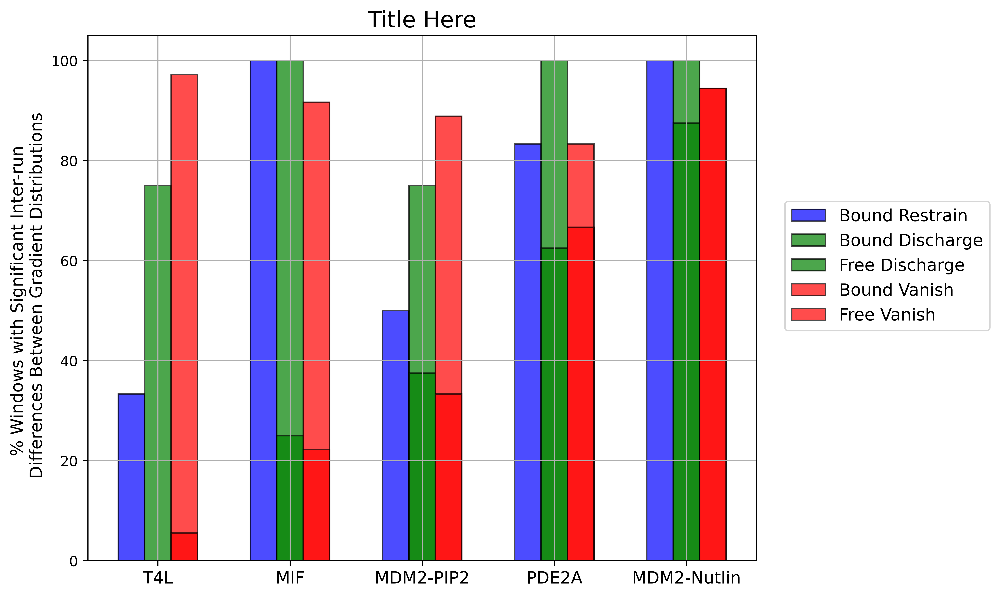

In [139]:
fig, ax = plt.subplots(figsize=(10, 6), dpi=600)
x = np.arange(len(systems))
width = 0.2

# Use a consistent color scheme
colors = ['blue', 'green', 'red', 'purple']

for i, stage in enumerate(grad_data[system]["30 ns"]["bound"]):
    ax.bar(x + (i * width), [sig_diff[system]["30 ns"]["bound"][stage] for system in systems], width, label=f"Bound {stage.capitalize()}", edgecolor="k", color=colors[i], alpha=0.7)
    if stage != "restrain":
        ax.bar(x + (i * width), [sig_diff[system]["30 ns"]["free"][stage] for system in systems], width, label=f"Free {stage.capitalize()}", edgecolor="k", color=colors[i], alpha=0.7)

ax.set_xticks(x + width)
ax.set_xticklabels(systems, fontsize=12)  # Increase font size
ax.set_ylabel("% Windows with Significant Inter-run \n Differences Between Gradient Distributions", fontsize=12)  # Increase font size
ax.set_title('Title Here', fontsize=16)  # Add a title and increase font size

ax.grid(True)  # Add grid lines

# Put label off to right of plot
ax.legend(bbox_to_anchor=(1.03, 0.7), fontsize=12)  # Increase font size

plt.tight_layout()

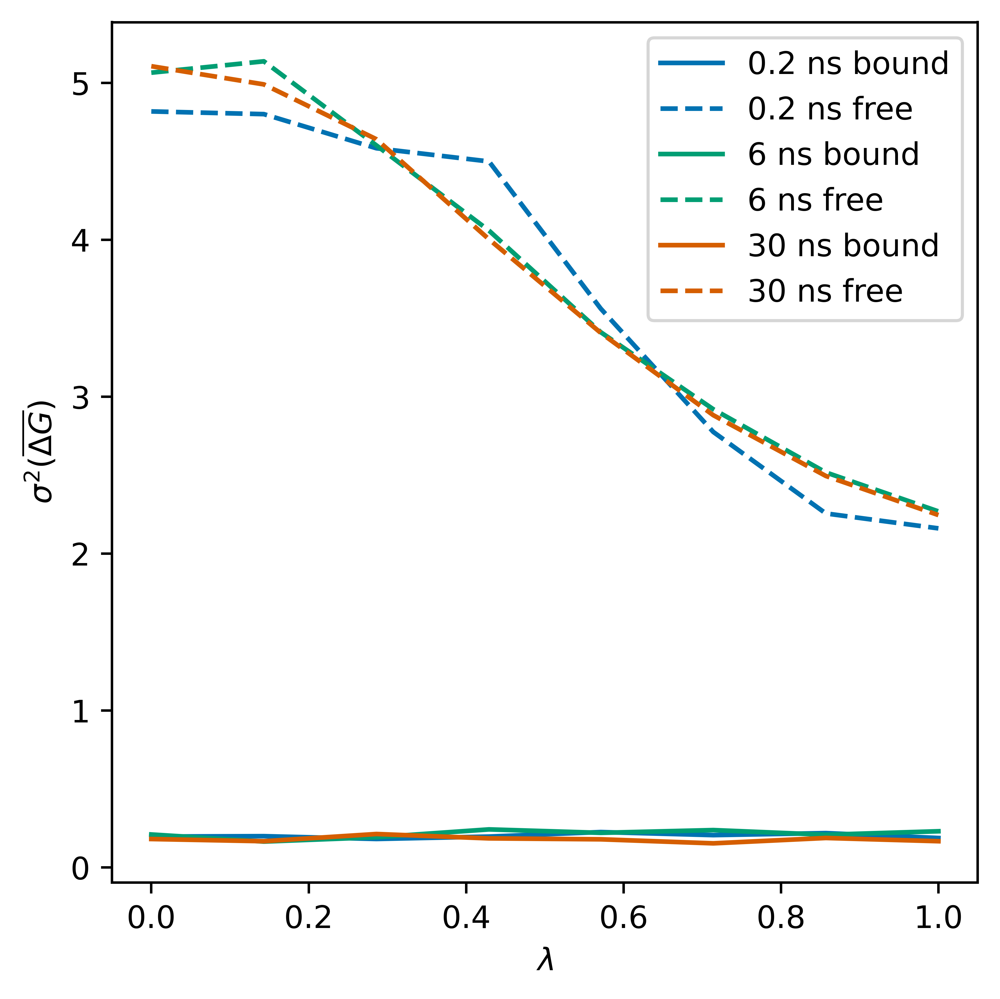

In [78]:
fig, ax = plt.subplots(1, 1, figsize=(5, 5), dpi=900)

for time in grad_data["T4L"]:
    # Ensure that we use the same color for each time
    color = ax._get_lines.get_next_color()
    for leg in grad_data["T4L"][time]:
        g_data = grad_data["T4L"][time][leg]["discharge"]
        line_style = {"bound": "-", "free": "--"}
        ax.plot(g_data.lam_vals, g_data.vars_intra, label=f"{time} {leg}", color=color, linestyle=line_style[leg])
ax.set_xlabel(r"$\lambda$")
ax.set_ylabel(r"$\sigma^2(\overline{\Delta G})$")
ax.legend()

fig.savefig("t4l_restrain.png", bbox_inches="tight", dpi=900)
plt.show()

In [11]:
g_data.vars_intra

[6.460366562553672,
 3.3848634527600696,
 2.0929453010716017,
 2.2562582201182044,
 1.187160714376107,
 0.4917496497308827]

In [3]:
grad_data

{'T4L': {'0.2 ns': {'bound': {'restrain': <EnsEquil.analyse.process_grads.GradientData at 0x7f66be6b2820>,
    'discharge': <EnsEquil.analyse.process_grads.GradientData at 0x7f65d4f86340>,
    'vanish': <EnsEquil.analyse.process_grads.GradientData at 0x7f65d4d75cd0>},
   'free': {'discharge': <EnsEquil.analyse.process_grads.GradientData at 0x7f65d4cc6ac0>,
    'vanish': <EnsEquil.analyse.process_grads.GradientData at 0x7f65d4cce8b0>}},
  '6 ns': {'bound': {'restrain': <EnsEquil.analyse.process_grads.GradientData at 0x7f65d4cde8e0>,
    'discharge': <EnsEquil.analyse.process_grads.GradientData at 0x7f65d4ce2fd0>,
    'vanish': <EnsEquil.analyse.process_grads.GradientData at 0x7f65d4cecdc0>},
   'free': {'discharge': <EnsEquil.analyse.process_grads.GradientData at 0x7f65d4c8dbb0>,
    'vanish': <EnsEquil.analyse.process_grads.GradientData at 0x7f65d4c949a0>}},
  '30 ns': {'bound': {'restrain': <EnsEquil.analyse.process_grads.GradientData at 0x7f65d4ca59d0>,
    'discharge': <EnsEquil.ana